# The stability of the global average on different window lengths
This notebook outllines different methods that can be used to de-trend the LongRunMIP and ZECMIP time series.

In [1]:
# Standard Library Imports
import os
import sys
from typing import List, Any, Callable, Union, Tuple, Optional
from importlib import reload
from time import sleep
# Third-Party Library Imports
import numpy as np
import pandas as pd
import xarray as xr
import climtas
from typing import NamedTuple
from enum import Enum
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
from functools import partial
from glob import glob
import cftime
import string
from numpy.typing import ArrayLike
# Custom Module Imports
sys.path.append(os.path.join(os.getcwd(), 'Documents', 'zecmip_stabilisation'))
import constants
sys.path.append(constants.MODULE_DIR)
import open_zecmip
import utils
# import signal_to_noise as sn
import plotting_functions
import xarray_extender as xe
import zec_calculation_functions
import signal_to_noise_calculations as sn_calc

# import drift_functions
import sn_plotting
import my_stats
# import signal_to_noise_calculations as sn_calc

# import sn_plotting_utils
# Suppress Warnings
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=RuntimeWarning, module='dask.*')
warnings.filterwarnings("ignore", category=Warning)
# # Logging
# logger = utils.get_notebook_logger()

Matplotlib created a temporary config/cache directory at /jobfs/122813292.gadi-pbs/matplotlib-fm6fif1h because the default path (/home/563/ab2313/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Matplotlib is building the font cache; this may take a moment.


In [2]:
sys.path.append(os.path.join(os.getcwd(), 'Documents', 'list_xarray'))
# from listXarray import listXarray
# import listXarray as lxr
from listXarray import listXarray, where, apply_ufunc, read_listxarray
# reload(lxr)
# from listXarray import array_function

In [3]:
# import listXarray
# reload(listXarray)
# from listXarray import listXarray

In [4]:
np.set_printoptions(precision=2, suppress=True, edgeitems=1)
xr.set_options(display_expand_data=False)

In [5]:
# client.close()

In [6]:
from dask.distributed import Client
client = Client(memory_limit=None, threads_per_worker=1, n_workers=12)
client

- State start
-   Scheduler at:     tcp://127.0.0.1:41457
-   dashboard at:         /proxy/8787/status
- Registering Worker plugin shuffle
-         Start Nanny at: 'tcp://127.0.0.1:44733'
-         Start Nanny at: 'tcp://127.0.0.1:43799'
-         Start Nanny at: 'tcp://127.0.0.1:42125'
-         Start Nanny at: 'tcp://127.0.0.1:45041'
-         Start Nanny at: 'tcp://127.0.0.1:44467'
-         Start Nanny at: 'tcp://127.0.0.1:42321'
-         Start Nanny at: 'tcp://127.0.0.1:33305'
-         Start Nanny at: 'tcp://127.0.0.1:38619'
-         Start Nanny at: 'tcp://127.0.0.1:35817'
-         Start Nanny at: 'tcp://127.0.0.1:32967'
-         Start Nanny at: 'tcp://127.0.0.1:33303'
-         Start Nanny at: 'tcp://127.0.0.1:44087'
- Register worker <WorkerState 'tcp://127.0.0.1:39109', name: 0, status: init, memory: 0, processing: 0>
- Starting worker compute stream, tcp://127.0.0.1:39109
- Starting established connection to tcp://127.0.0.1:51998
- Register worker <WorkerState 'tcp://127

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 12
Total threads: 12,Total memory: 0 B
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41457,Workers: 12
Dashboard: /proxy/8787/status,Total threads: 12
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:39109,Total threads: 1
Dashboard: /proxy/36017/status,Memory: 0 B
Nanny: tcp://127.0.0.1:44733,


- Event loop was unresponsive in Nanny for 3.00s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 3.05s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Scheduler for 3.12s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 3.31s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 3.36s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 3.39s.  This is often caused by long-r

# Calculations

## Opening Data

In [7]:
chunks = {'lat':-1, 'lon':-1, 'time':-1, 'ensemble':-1}

In [8]:
a1_raw_data = (open_zecmip.extract_experiment_into_xrlist(
    '1000pgc', 'tas', chunks=chunks, logginglevel='ERROR')
                 .to_dataarray('tas')
                 .sort_by_refkey())

In [9]:
a1_raw_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'ensemble': 1, 'model': 1, 'time': 1212, 'lat': 145, 'lon': 192})
CESM2          (dataArray): ({'ensemble': 1, 'model': 1, 'time': 1800, 'lat': 192, 'lon': 288})
CanESM5        (dataArray): ({'ensemble': 5, 'model': 1, 'time': 1200, 'lat': 64, 'lon': 128})
GFDL-ESM4      (dataArray): ({'ensemble': 1, 'model': 1, 'time': 2400, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'ensemble': 1, 'model': 1, 'time': 2160, 'lat': 90, 'lon': 144})
MIROC-ES2L     (dataArray): ({'ensemble': 1, 'model': 1, 'time': 2976, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'ensemble': 1, 'model': 1, 'time': 2220, 'lat': 96, 'lon': 192})
NorESM2-LM     (dataArray): ({'ensemble': 1, 'model': 1, 'time': 1200, 'lat': 96, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'ensemble': 4, 'model': 1, 'time': 3960, 'lat': 144, 'lon': 192})

In [10]:
a1_raw_data.sel(model=['CESM2', 'NorESM2-LM'])

key_dim = model


Number of da/ds: 2
---------------
CESM2      (dataArray): ({'ensemble': 1, 'model': 1, 'time': 1800, 'lat': 192, 'lon': 288})
NorESM2-LM (dataArray): ({'ensemble': 1, 'model': 1, 'time': 1200, 'lat': 96, 'lon': 144})

In [11]:
a1_raw_data.isel(model=[1,2,4])

key_dim = model


Number of da/ds: 3
---------------
ACCESS-ESM1-5 (dataArray): ({'ensemble': 1, 'model': 1, 'time': 1800, 'lat': 192, 'lon': 288})
CESM2         (dataArray): ({'ensemble': 5, 'model': 1, 'time': 1200, 'lat': 64, 'lon': 128})
CanESM5       (dataArray): ({'ensemble': 1, 'model': 1, 'time': 2160, 'lat': 90, 'lon': 144})

In [12]:
pct_raw_data =  (open_zecmip.extract_experiment_into_xrlist('1pct', 'tas', chunks=chunks)
                   .to_dataarray('tas')
                   .sort_by_refkey())

In [13]:
# pi-Control (not ESM)
esmpi_raw_data = (open_zecmip.extract_experiment_into_xrlist('picontrol', 'tas', chunks=chunks, logginglevel='INFO')
                    .to_dataarray('tas')
                    .isel(ensemble=0)
                    .squeeze('ensemble')
                    .sort_by_refkey()
                    .rename({'latitude':'lat', 'longitude': 'lon'}))

- ACCESS-ESM1-5
-      r1i1p1f1 - /g/data/fs38/publications/CMIP6/CMIP/CSIRO/ACCESS-ESM1-5/piControl/r1i1p1f1/Amon/tas/gn/v20210316/*.nc
- CanESM5
-      r1i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/CCCma/CanESM5/piControl/r1i1p1f1/Amon/tas/gn/v20190429/*.nc
-      r1i1p2f1 - /g/data/oi10/replicas/CMIP6/CMIP/CCCma/CanESM5/piControl/r1i1p2f1/Amon/tas/gn/v20190429/*.nc
- MIROC-ES2L
-      r1i1p1f2 - /g/data/oi10/replicas/CMIP6/CMIP/MIROC/MIROC-ES2L/piControl/r1i1p1f2/Amon/tas/gn/v20190823/*.nc
- UKESM1-0-LL
-      r1i1p1f2 - /g/data/oi10/replicas/CMIP6/CMIP/MOHC/UKESM1-0-LL/piControl/r1i1p1f2/Amon/tas/gn/v20200828/*.nc
- MPI-ESM1-2-LR
-      r1i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/MPI-M/MPI-ESM1-2-LR/piControl/r1i1p1f1/Amon/tas/gn/v20190710/*.nc
-      r2i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/MPI-M/MPI-ESM1-2-LR/piControl/r2i1p1f1/Amon/tas/gn/v20190815/*.nc
- GISS-E2-1-G-CC
-      r1i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G-CC/piControl/r1i1p1f1/Amon/tas/gn/v2

In [14]:
### ESM-pi-Control
# esmpi_raw_data = (open_zecmip.extract_experiment_into_data('esm-piControl', 'tas', logginglevel='INFO') #esm-piControl'
#                     .to_dataarray('tas')
#                     # .isel(ensemble=0)
#                     # .squeeze('ensemble')
#                     .sort_by_refkey()
#                     .rename({'latitude':'lat', 'longitude': 'lon'}))

In [15]:
esmpi_raw_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'time': 12000, 'lat': 145, 'lon': 192})
CESM2          (dataArray): ({'model': 1, 'time': 14400, 'lat': 192, 'lon': 288})
CanESM5        (dataArray): ({'model': 1, 'time': 16800, 'lat': 64, 'lon': 128})
GFDL-ESM4      (dataArray): ({'model': 1, 'time': 6000, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'time': 1980, 'lat': 90, 'lon': 144})
MIROC-ES2L     (dataArray): ({'model': 1, 'time': 6000, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'time': 12000, 'lat': 96, 'lon': 192})
NorESM2-LM     (dataArray): ({'model': 1, 'time': 6012, 'lat': 96, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'model': 1, 'time': 22560, 'lat': 144, 'lon': 192})

In [16]:
# Making sure that the ensembles match. NOTE -  this can not be done
# with the piControl
a1_raw_data = a1_raw_data.cross_match_dim(pct_raw_data, 'ensemble')
pct_raw_data = pct_raw_data.cross_match_dim(a1_raw_data, 'ensemble')

In [17]:
# We are just looking at a single ensemble here.
a1_raw_data = a1_raw_data.isel(ensemble=0)
pct_raw_data = pct_raw_data.isel(ensemble=0)
esmpi_raw_data = esmpi_raw_data.isel(ensemble=0)

In [18]:
mask_ds = xr.open_dataset(os.path.join(constants.ZECMIP_LOCAL_DIR, 'landsea_mask.nc')) #_regridd_MPI_ESM
# mask_data = xr.open_dataset(os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, 'landsea_mask_regridd_MPI_ESM.nc')); mask_data
mask_ds

<xarray.Dataset> Size: 150kB
Dimensions:  (lat: 96, lon: 192)
Coordinates:
  * lat      (lat) float64 768B -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon      (lon) float64 2kB 0.0 1.875 3.75 5.625 ... 352.5 354.4 356.2 358.1
Data variables:
    mask     (lat, lon) int64 147kB ...
Attributes:
    Original model:  Made from data found at /g/data/oi10/replicas/CMIP6/C4MI...

In [19]:
import xesmf
regridded_file_list = []
for model in a1_raw_data.model:
    print(model)
    
    target_ds = a1_raw_data[model].isel(time=0).squeeze().drop(['ensemble', 'model', 'time'])
    
    regridder = xesmf.Regridder(mask_ds.mask , target_ds, method='nearest_s2d')
    regridded_file = regridder(mask_ds.mask)
    regridded_file = regridded_file.expand_dims(model=[model])
    regridded_file_list.append(regridded_file)

mask_data = listXarray(regridded_file_list, 'model')

ACCESS-ESM1-5


[gadi-cpu-spr-0158.gadi.nci.org.au:467983] shmem: mmap: an error occurred while determining whether or not /jobfs/122813292.gadi-pbs/ompi.gadi-cpu-spr-0158.13954/jf.0/3119644672/shared_mem_cuda_pool.gadi-cpu-spr-0158 could be created.
[gadi-cpu-spr-0158.gadi.nci.org.au:467983] create_and_attach: unable to create shared memory BTL coordinating structure :: size 134217728 


CESM2
CanESM5
GFDL-ESM4
GISS-E2-1-G-CC
MIROC-ES2L
MPI-ESM1-2-LR
NorESM2-LM
UKESM1-0-LL


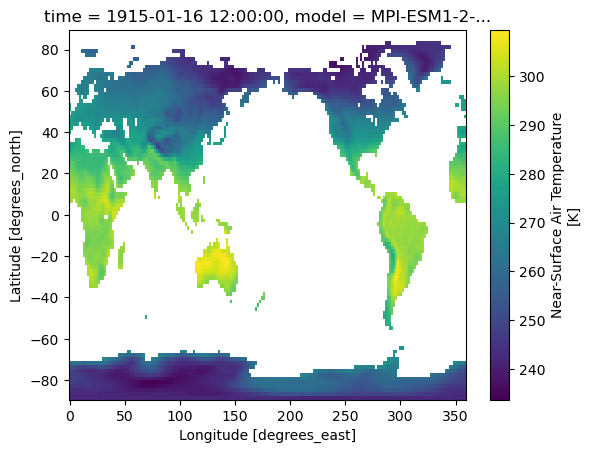

In [20]:
a1_raw_data[6].where(mask_data[6]).isel(time=0).plot()

In [21]:
# Convert to celcius
a1_raw_data = a1_raw_data - 273.15
pct_raw_data = pct_raw_data - 273.15
esmpi_raw_data = esmpi_raw_data - 273.15

In [22]:
# Can remove a lot of data, as I don't actually need this past the 70 year mark
# Data is montly so times by 12, a do 100 points just for saftery
pct_raw_data = pct_raw_data.isel(time=slice(0, 100 * 12))

In [23]:
# Yearly data transfomration - montly resolution is not needed
esmpi_data = esmpi_raw_data.chunk({'time':-1}).resample(time='Y').mean(dim='time').set_refkeys('model')
pct_resample_data = pct_raw_data.chunk({'time':-1}).resample(time='Y').mean(dim='time').set_refkeys('model')
a1_data = a1_raw_data.chunk({'time':-1}).resample(time='Y').mean(dim='time').set_refkeys('model')

# Can see this in the global mean time series. But this has errors after 1000
esmpi_data['CanESM5'] = esmpi_data['CanESM5'].isel(time=slice(None, 1000))

In [24]:
# Reduce time so that the smalles time densions matches. This is at 101 years
a1_data = a1_data.isel(time=slice(None, 100))

## Regridding Data

In [25]:
def regrid_with_climtas(ds, target_data):
        regridder = climtas.regrid.Regridder(ds, target_data)
        regridded_data = regridder.regrid(ds).compute()
        # Sometimes the re-gridd will remove the coordinates from the array
        coord_dict = dict(lat=regridded_data.lat.values, lon=regridded_data.lon.values)

        regridded_data=regridded_data.assign_coords(coord_dict)
        return regridded_data

In [26]:
def regrid_listxarray(lxr, target_model):
    regridd_list = []
    for model in range(len(lxr)):
        print(f'{model}, ', end='')
        regridded_data = regrid_with_climtas(lxr[model] , lxr[target_model])
        regridd_list.append(regridded_data)
    lxr_regridded = listXarray(regridd_list, 'model')
    return lxr_regridded

In [27]:
# %%time
# esmpi_data = regrid_listxarray(esmpi_data, 'MPI-ESM1-2-LR')

In [28]:
# %%time
# a1_data = regrid_listxarray(a1_data, 'MPI-ESM1-2-LR')

In [29]:
# %%time
# pct_data = regrid_listxarray(pct_data, 'MPI-ESM1-2-LR')

In [30]:
# models = a1_data.refkeys
# ncols = 3
# nrows = int(len(models)/ncols)
# fig = plt.figure(figsize=(12, 12))
# axes = [fig.add_subplot(nrows, ncols, i+1) for i in range(ncols*nrows)]

# for num, model in enumerate(models):
#     ax = axes[num]
#     a1_data[model].isel(time=-10).plot(ax=ax)

In [31]:
# models = a1_data.refkeys
# ncols = 3
# nrows = int(len(models)/ncols)
# fig = plt.figure(figsize=(12, 12))
# axes = [fig.add_subplot(nrows, ncols, i+1) for i in range(ncols*nrows)]

# for num, model in enumerate(models):
#     ax = axes[num]
#     esmpi_data[model].isel(time=100).plot(ax=ax)
#     ax.set_title(model)


In [32]:
# models = a1_data.refkeys
# ncols = 3
# nrows = int(len(models)/ncols)
# fig = plt.figure(figsize=(12, 12))
# axes = [fig.add_subplot(nrows, ncols, i+1) for i in range(ncols*nrows)]

# for num, model in enumerate(models):
#     ax = axes[num]
#     pct_data[model].isel(time=-10).plot(ax=ax)

In [33]:
# esmpi_data[8].isel(lon=0).isel(time=slice(0,20)).squeeze().plot();

In [34]:
# a1_data['UKESM1-0-LL'].isel(lon=0).isel(time=slice(0,20)).squeeze().plot();

In [35]:
# a1_data['UKESM1-0-LL'].isel(lon=0).isel(time=slice(0,20)).squeeze().plot();

## Anomaly Calculation

In [36]:
branch_point_mean_data = pct_resample_data(
    zec_calculation_functions.calculate_branch_average,
    a1_data, logginglevel='INFO')

- <function calculate_branch_average at 0x1513dd1a31c0> has been called
- ACCESS-ESM1-5
- ['ACCESS-ESM1-5'] - ['ACCESS-ESM1-5']
- branch_start_time=cftime.DatetimeProlepticGregorian(168, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=67
- 

- CESM2
- ['CESM2'] - ['CESM2']
- branch_start_time=cftime.DatetimeNoLeap(68, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=67
- 

- CanESM5
- ['CanESM5'] - ['CanESM5']
- branch_start_time=cftime.DatetimeNoLeap(1911, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=61
- 

- GFDL-ESM4
- ['GFDL-ESM4'] - ['GFDL-ESM4']
- branch_start_time=cftime.DatetimeNoLeap(64, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=63
- 

- GISS-E2-1-G-CC
- ['GISS-E2-1-G-CC'] - ['GISS-E2-1-G-CC']
- branch_start_time=cftime.DatetimeNoLeap(1920, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=70
- 

- MIROC-ES2L
- ['MIROC-ES2L'] - ['MIROC-ES2L']
- branch_start_time=cftime.DatetimeGregorian(1913, 12, 31, 0, 0, 0, 0,

In [37]:
# # Base period calculation - 20 year average at branch poin
# branch_point_mean_data = listXarray([zec_calculation_functions.calculate_branch_average(
#     pct_data[model], a1_data[model], logginglevel='INFO') for model in pct_data.refkeys]).set_refkeys('model')

In [38]:
# Amomaly time series from the branch point (previosuly called 'experiment_zec_da_anom')
a1_anom_data = (a1_data - branch_point_mean_data)#.compute()

In [39]:
# This way procudes the same as when you average first then take the anomalies. However, we also get the anomaleis
# time series which is useful
zec25_data = a1_anom_data.isel(time=slice(15, 35)).mean(dim='time').compute()
zec50_data = a1_anom_data.isel(time=slice(40, 60)).mean(dim='time').compute()
zec90_data = a1_anom_data.isel(time=slice(80, 100)).mean(dim='time').compute()
zec50_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'lat': 145, 'lon': 192})
CESM2          (dataArray): ({'model': 1, 'lat': 192, 'lon': 288})
CanESM5        (dataArray): ({'model': 1, 'lat': 64, 'lon': 128})
GFDL-ESM4      (dataArray): ({'model': 1, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'lat': 90, 'lon': 144})
MIROC-ES2L     (dataArray): ({'model': 1, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'lat': 96, 'lon': 192})
NorESM2-LM     (dataArray): ({'model': 1, 'lat': 96, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'model': 1, 'lat': 144, 'lon': 192})

In [40]:
np.take(esmpi_data.dim('time', output='dict')['CanESM5'], [0,1,2,-3,-2,-1])

array([cftime.DatetimeNoLeap(5201, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(5202, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(5203, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(6198, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(6199, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(6200, 12, 31, 0, 0, 0, 0, has_year_zero=True)],
      dtype=object)

In [41]:
# Reset to time zero
a1_anom_data = a1_anom_data(utils.reset_time_to_0_start, parallel_call=True)
pct_data = pct_resample_data(utils.reset_time_to_0_start, parallel_call=True)
esmpi_data = esmpi_data(utils.reset_time_to_0_start, parallel_call=True)

In [42]:
np.take(esmpi_data.dim('time', output='dict')['CanESM5'], [0,1,2,-3,-2,-1])

array([cftime.datetime(1, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(2, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(3, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(998, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(999, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(1000, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False)],
      dtype=object)

In [43]:
# These two can be computed as they are small (combined is around  100mb with each 
# model being around 7mb
a1_anom_data = a1_anom_data.compute()
pct_data = pct_data.compute()

In [44]:
# Each model is around 100mb. Parallel across this would be great. But would be 
# too much effort for now
esmpi_data = esmpi_data.compute()

In [48]:
a1_anom_trend_data = a1_anom_data(my_stats.trend_fit, method='polynomial', order=4)
# a1_anom_trend_data=  my_stats_trend_fit(a1_anom_data, method='polynomial', order=4)
a1_anom_detrend_data= a1_anom_data - a1_anom_trend_data

In [50]:
a1_anom_data.sel(lat=-38, method='nearest')

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'time': 100, 'lon': 192})
CESM2          (dataArray): ({'model': 1, 'time': 100, 'lon': 288})
CanESM5        (dataArray): ({'model': 1, 'time': 100, 'lon': 128})
GFDL-ESM4      (dataArray): ({'model': 1, 'time': 100, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'time': 100, 'lon': 144})
MIROC-ES2L     (dataArray): ({'model': 1, 'time': 100, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'time': 100, 'lon': 192})
NorESM2-LM     (dataArray): ({'model': 1, 'time': 100, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'model': 1, 'time': 100, 'lon': 192})

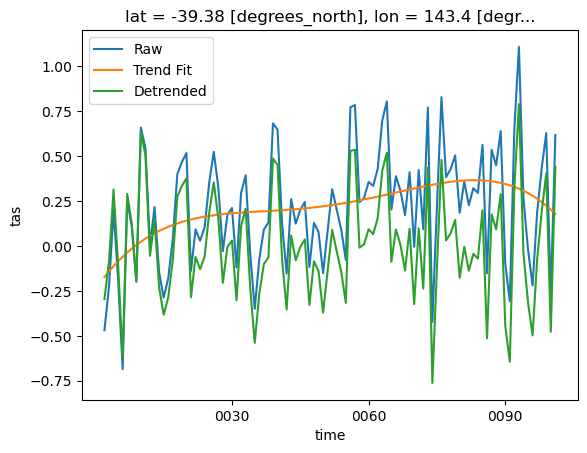

In [51]:
model = 'UKESM1-0-LL'#'CESM2'
a1_anom_data.sel(model=model).sel(lat=-39, lon=144, method='nearest').plot(label='Raw')
a1_anom_trend_data.sel(model=model).sel(lat=-39, lon=144, method='nearest').plot(label='Trend Fit')
a1_anom_detrend_data.sel(model=model).sel(lat=-39, lon=144, method='nearest').plot(label='Detrended')
plt.legend()

In [85]:
class Region(NamedTuple):
    name: str
    slice: tuple

class regionLatLonTuples(Enum):
    GLOBAL = Region('gl', slice(None, None))
    LAND = Region('land', slice(None, None))
    OCEAN = Region('ocean', slice(None, None))
    NH = Region('nh', slice(0, None))
    SH = Region('sh', slice(None, 0))
    TROPICS = Region('tropics', slice(-23, 23))
    MID_LAT_SH = Region('mid_sh', slice(-66, -23))
    MID_LAT_NH = Region('mid_nh', slice(23, 66))
    ARCTIC = Region('arctic', slice(66, None))
    ANTARCTIC = Region('antarctic', slice(None, -66))


NAMING_MAP = {
    'global': 'Global',
    'nh': 'Northern Hemisphere',
    'sh': 'Southern Hemisphere',
    'tropics': 'Tropics',
    'land': 'Land',
    'ocean': 'Ocean',
    'mid_nh': 'Mid Latitudes NH',
    'mid_sh': 'Mid Latitudes SH',
    'arctic': 'Arctic',
    'antarctic': 'Antarctic'}

In [86]:
def fraction_comparison(ds_num, ds_denom, weights):
    """
    Calculate the percentage by comparing two datasets.

    Parameters:
        ds_num (xarray.Dataset): Numerator dataset.
        ds_denom (xarray.Dataset): Denominator dataset.
        weights (xarray.DataArray): Weights for the calculation.

    Returns:
        xarray.DataArray: Dataset containing the percentage.
    """
    # Calculate the sum of the numerator dataset weighted by weights
    ds_num_sum = ds_num.weighted(weights).sum(dim=['lat', 'lon'])

    # Calculate the sum of the denominator dataset weighted by weights
    ds_denom_sum = ds_denom.weighted(weights).sum(dim=['lat', 'lon'])

    # Calculate the percentage
    percent_data = ds_num_sum / ds_denom_sum * 100

    return percent_data

In [87]:
def calculate_returned_binary_data(arr: ArrayLike, year_of_emergence: int, time_years: ArrayLike) -> ArrayLike:
    """
    Calculates a binary array representing the emergence of an event.

    E.g. after stabilisation all values will be 1, whilst before stabilisation
    all years will be 0

    Parameters:
        arr (ArrayLike): Input array.
        year_of_emergence (int): Year of the event's emergence.
        time_years (ArrayLike): Array of years.

    Returns:
        ArrayLike: Binary array representing the event's emergence.
                   0 before the year_of_emergence, 1 after.

    If year_of_emergence is NaN or all values in arr are NaN, the function
    returns arr unchanged.
    """

    #print(arr.shape, year_of_emergence, end='')
    # If the year_of_emergence is nan or all the values at the location are nan
    # then return nan
    
    if np.isnan(year_of_emergence): return arr

    # The integer arguement of where the time_years equals the emergence arg
    emergence_arg = np.argwhere(time_years == np.round(year_of_emergence))
    
    if len(emergence_arg) == 0:
        print(year_of_emergence)
        return np.nan
    if isinstance(emergence_arg, int): pass
    elif emergence_arg.shape == (1,1): emergence_arg = emergence_arg.item()
    
    to_return = np.zeros_like(arr)
    
    # Set all values to 1 after emergence has occured
    to_return[emergence_arg:] =  1

    return to_return

In [88]:
def create_regions(binary_emergence_data: xr.Dataset, land_mask_data:xr.Dataset) -> xr.Dataset:
    """
    Calculate the percentage of stability for regions based on binary emergence data.

    Parameters:
        binary_emergence_data (xr.Dataset): Dataset containing binary emergence data.
        land_mask_data (xr.Dataset): Dataset containing land mask data.
        only_1s_data (xr.Dataset): Dataset with only values of 1. This is needed as it can differ
                                due to data availability

    Returns:
        xr.Dataset: Dataset with percentage of stability for each region.

    This function calculates the percentage of stability for regions based on binary
    emergence data and land mask information. It assumes the existence of a variable
    'only_1s_data' that is the same shape as 'binary_emergence_data' and contains only
    values of 1 where the event has occurred.
    """

    # Calculating the weights
    weights = np.cos(np.deg2rad(binary_emergence_data.lat))
    weights.name = 'weights'

    # The two regions that need the land-sea make
    NEEDS_MASKING = ['land', 'ocean']

    ds_collection = [] # Storing all the datasets
    points_in_region_dict = {} # The number of 
    for region in regionLatLonTuples:
        region_name = region.value.name.lower()
        lat_slice = region.value.slice
        
        # Select data for the current region
        ds_region = binary_emergence_data.sel(lat=lat_slice).expand_dims({'region':[region_name]})

        # Apply masking if needed
        if region_name in NEEDS_MASKING:
            mask_to_use_data = xr.where(land_mask_data, 1, 0) if region_name == 'land' else xr.where(land_mask_data, 0, 1) 
            ds_region = ds_region.where(mask_to_use_data)


        ds_collection.append(ds_region)

    ds_regions = xr.concat(ds_collection, dim='region')

    return ds_regions

In [89]:
mask_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'lat': 145, 'lon': 192})
CESM2          (dataArray): ({'model': 1, 'lat': 192, 'lon': 288})
CanESM5        (dataArray): ({'model': 1, 'lat': 64, 'lon': 128})
GFDL-ESM4      (dataArray): ({'model': 1, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'lat': 90, 'lon': 144})
MIROC-ES2L     (dataArray): ({'model': 1, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'lat': 96, 'lon': 192})
NorESM2-LM     (dataArray): ({'model': 1, 'lat': 96, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'model': 1, 'lat': 144, 'lon': 192})

In [90]:
weight_list = []
for model in mask_data.model:
    weights = np.cos(np.deg2rad(mask_data[model].lat))
    weight_list.append(weights.expand_dims(model=[model]))
weight_data = listXarray(weight_list, mask_data.key_dim)
weight_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'lat': 145})
CESM2          (dataArray): ({'model': 1, 'lat': 192})
CanESM5        (dataArray): ({'model': 1, 'lat': 64})
GFDL-ESM4      (dataArray): ({'model': 1, 'lat': 180})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'lat': 90})
MIROC-ES2L     (dataArray): ({'model': 1, 'lat': 64})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'lat': 96})
NorESM2-LM     (dataArray): ({'model': 1, 'lat': 96})
UKESM1-0-LL    (dataArray): ({'model': 1, 'lat': 144})

In [91]:
# # Calculating the weights
# weights = np.cos(np.deg2rad(mask_data[0].lat))
# weights.name = 'weights'

In [92]:
# Using the year when each window becomes stable. Create a data set that is
# 0 when unstable and 1 when stable. 
binary_stability_data = apply_ufunc( #xr
    calculate_returned_binary_data,
    unstable_sn_data.isel(window=0), # This is just a place holder, used for the shape
    year_stable_data,
    unstable_sn_data[0].time.dt.year-1, # Subtracting one, as this is ofset by 1
    input_core_dims = [['time'], [], ['time']],
    output_core_dims=[['time']],
    vectorize=True,
    dask='parallelized'
)

60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0
60.0


In [93]:
# A dataset with every point as 1, this is useful for getting the maximum weighted sum for a field
# full_data = xr.where(np.isfinite(binary_stability_data), 1, 1)
full_data = where(binary_stability_data(np.isfinite), 1, 1)

In [94]:
binary_stability_data_regions = binary_stability_data(create_regions, mask_data)

In [95]:
full_data_regions = full_data(create_regions,  mask_data)

In [96]:
# binary_stability_data_regions['CESM2'].sum(dim=['lat', 'lon']).plot(hue='region')

In [97]:
# for model in binary_stability_data_regions.model:
#     region_model_ds = 
#     full_model_ds = 
#     fraction_model_ds = fraction_comparison(region_model_ds, full_model_ds, weights_model_ds)

In [98]:
percent_stable_timeseries_ds = binary_stability_data_regions(
    fraction_comparison, full_data_regions, weight_data).concat(dim='model')

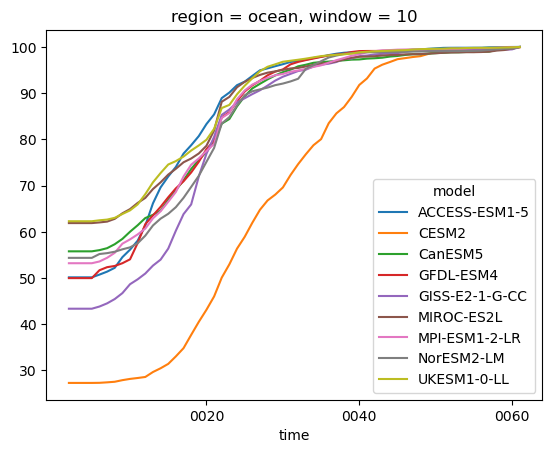

In [99]:
percent_stable_timeseries_ds.isel(region=2).plot(hue='model');

In [100]:
region_order = ['gl', 'nh', 'sh', 'land', 'ocean', 'arctic', 'antarctic', 'mid_nh', 'mid_sh', 'tropics']
percent_stable_timeseries_ds = percent_stable_timeseries_ds.sel(region=region_order)

In [101]:
# percent_stable_timeseries_data = percent_stable_timeseries_data.compute()
# percent_stable_timeseries_data

In [102]:
# Opposite of the above: Stable replace with 0n and unstable is 1.
# The opposite is need as we are looking at when the percetage of unstable points becomes 0
binary_unstable_data = where(binary_stability_data, 0, 1) #xr
binary_unstable_warm_data = binary_unstable_data.where(stable_anom_da>0)
binary_unstable_cool_data = binary_unstable_data.where(stable_anom_da<=0)

In [103]:
# The number of cooling and warming trends at each grid cell
number_warm_data = binary_unstable_warm_data(fraction_comparison, full_data, weight_data)#.expand_dims(region=['global_warm']) 
number_cool_data = binary_unstable_cool_data(fraction_comparison, full_data, weight_data)#.expand_dims(region=['global_warm']) 

In [104]:
number_cool_data = number_cool_data.compute().concat(dim='model').drop(['ensemble', 'window'])
number_warm_data = number_warm_data.compute().concat(dim='model').drop(['ensemble', 'window'])

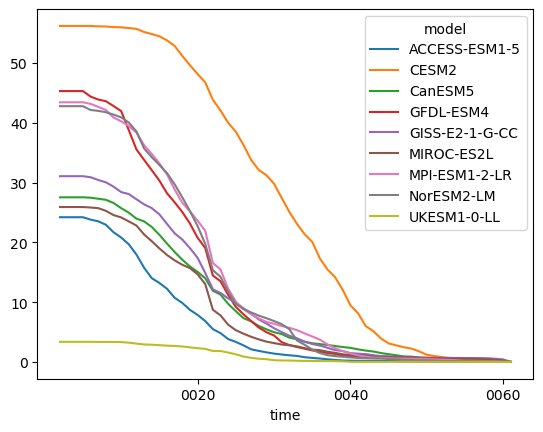

In [105]:
number_cool_data.plot(hue='model');

In [106]:
# percent_stable_timeseries_ds = percent_stable_timeseries_data.concat(dim='model')
# percent_stable_timeseries_ds

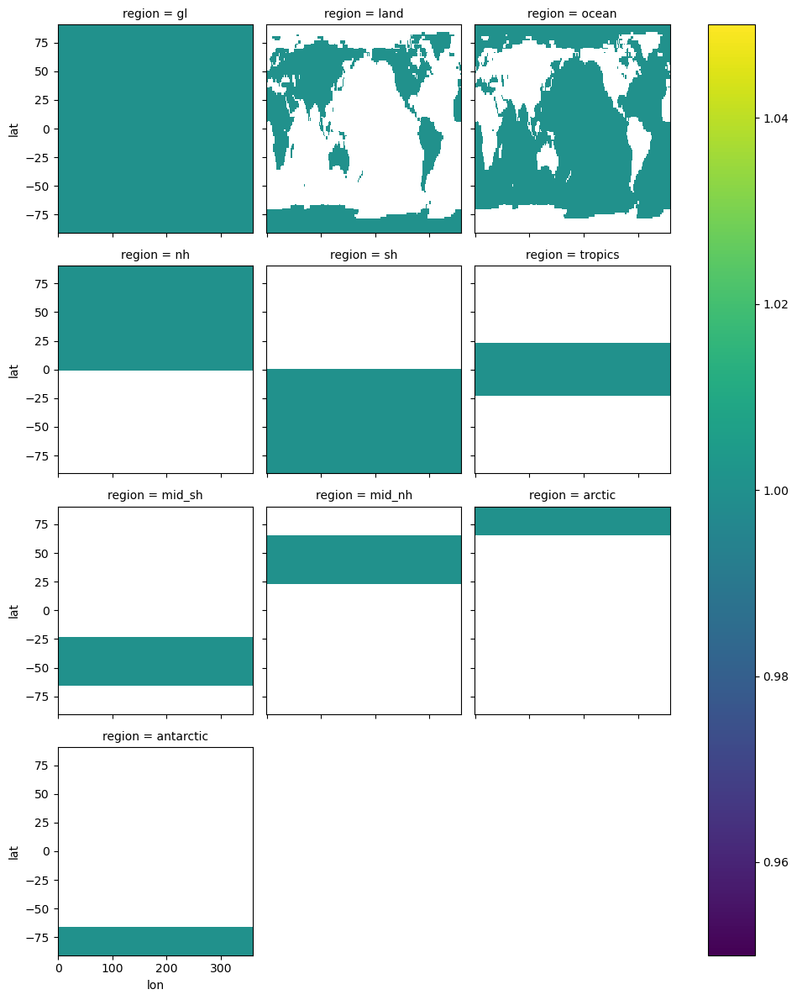

In [107]:
full_data_regions.isel(model=0).isel(time=1).plot(col='region', col_wrap=3)

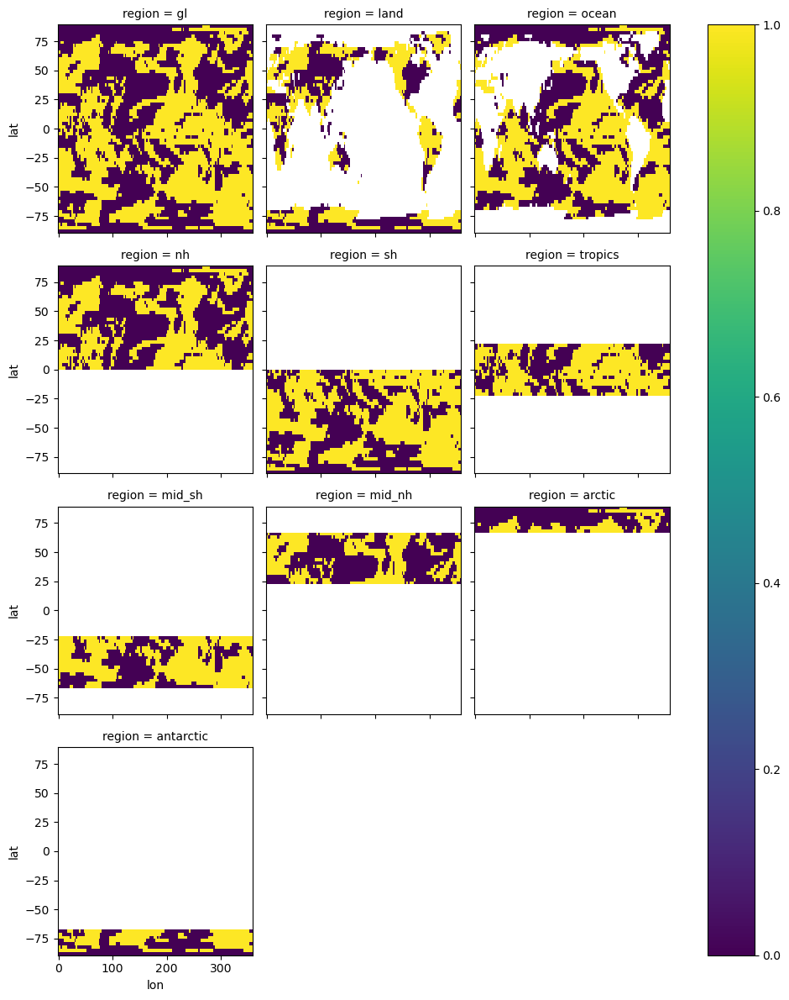

In [108]:
binary_stability_data_regions.isel(model=2).isel(time=1).plot(col='region', col_wrap=3)

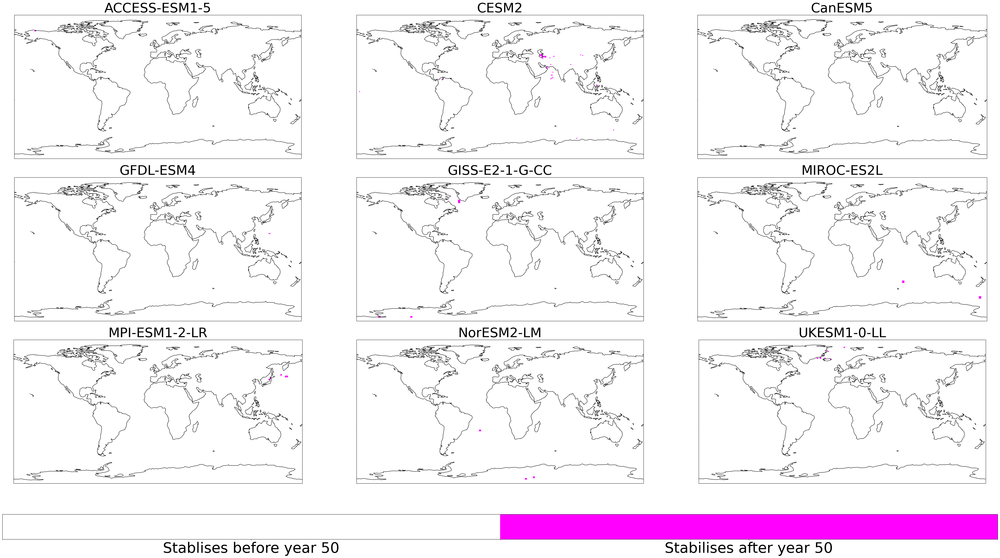

In [146]:

# 20-year window levels
# vm = 30; step=2; levels_stable = np.arange(0, vm+step, step) 
# 40-year window levels
vm = 60; step=5; levels_stable = np.arange(0, vm+step, step) 

ncols, nrows = 3, 3
num_plots = ncols * nrows

fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs_top = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.15]*2, wspace=.1)
gs_bottom = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.15]*2, hspace=0)

axes = [fig.add_subplot(gs_top[i], projection=projection_init) for i in range(0, num_plots)]
cax1 = plt.subplot(gs_bottom[nrows+0, :])



### Data plotting
# , stabilisation_method = 'blackout'
stable_plot_kwargs = dict(dim='model', extend='neither', add_label=False,
    max_stabilisation_year=60, font_scale=2, projection=ccrs.PlateCarree, ptype='imshow')

fig, gs, axes, cbar1 = sn_plotting.map_plot_all_for_coords_3(
    where(year_stable_data >=60, 1, 0), 
    # xr.where(year_stable_data >50, 1, 0), 
    fig=fig, gs=gs_top, axes=axes, cax=cax1, cmap=cmap_binary, levels=[0, 1, 2],
    cbar_title="", **stable_plot_kwargs)

cbar1[0].ax.set_xticks([0.5,1.5])
cbar1[0].ax.set_xticklabels(['Stablises before year 50', 'Stabilises after year 50'])
cbar1[0].ax.tick_params(labelsize=44)  # Set font size to 14

### Figure S13 (stability bounds)

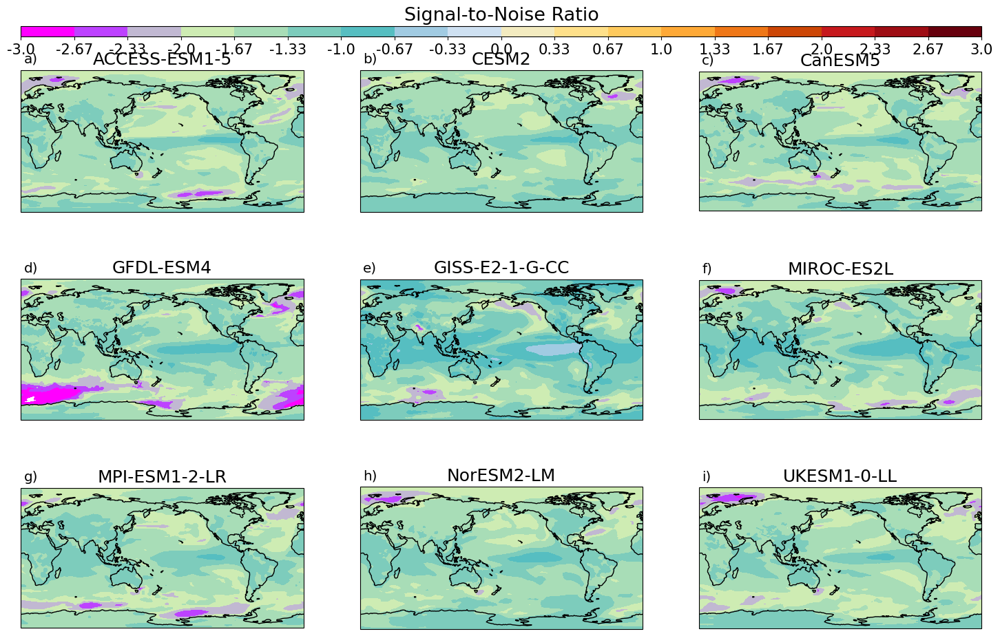

In [147]:
fig = plt.figure(figsize=(18, 12))
gs = gridspec.GridSpec(4, 3, height_ratios = [0.05] + [1]*3, hspace=0)
axes = [fig.add_subplot(gs[i+3], projection=ccrs.PlateCarree(central_longitude=180)) for i in range(9)]
# axes= [fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree()), 
#        fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())]

fig, gs, axes, cax = sn_plotting.map_plot_all_for_coords_3(
    sn_ratio_bounds_data.lower_bound.mean(dim='window'), dim='bound',
    levels=sn_levels, projection=projection, cmap=sn_cmap, font_scale=0.9,
    cbar_title="Signal-to-Noise Ratio", extend='neither',
    fig=fig, gs=gs,
    axes =axes,
    cax = plt.subplot(gs[0, :]),
    add_colorbar=True,
)

# axes[0].set_title('Lower S/N Rario Bound', fontsize=14)
# axes[1].set_title('Upper S/N Ratio Bound', fontsize=14)

# Forced Response

TO DO
* Apply pymankendall (local and single point)
* Look at S/N ratio
    * Can be linear and lowess signal
* Pattern correlations between the zec50 and the linear signal
* Is the macdougal method a bad way of estimating the ZEC?
    * Locations where the ZEC is intially really large
 
* Is the change actually more negative, just that the Macdougal method does not take into accout internal variability/ there are shocks at teh start, and this is not considered corretly.
    * Need to fit linear trend to the GMST data series
    * GSMT trend over 50 years and over 100 years

Plots to make 
* Locations of largest shocks (year one temperature anomalies)
* Sample time series of shocks (inc ZEC50, linear trend)
* Contribution to base period average of first 10 vs. last 10 year
* Signal vs. ZEC50
* ZEC50 - signal
* Scatter - shock vs. zec90 - forced 100
* Scatter -  difference between start and end of base vs  zec90 - forced 100

## Calculations

In [148]:
from scipy.stats import spearmanr
from matplotlib.colors import BoundaryNorm
from scipy.stats import linregress
from matplotlib import ticker as mticker
import pymannkendall as mk

In [149]:
pct_resample_data = pct_resample_data.compute()
a1_data =  a1_data.compute()

In [150]:
zec50_data = zec50_data.compute()

In [151]:
static_noise_data = a1_anom_detrend_data.std(dim='time').compute()
static_noise_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'lat': 145, 'lon': 192})
CESM2          (dataArray): ({'model': 1, 'lat': 192, 'lon': 288})
CanESM5        (dataArray): ({'model': 1, 'lat': 64, 'lon': 128})
GFDL-ESM4      (dataArray): ({'model': 1, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'lat': 90, 'lon': 144})
MIROC-ES2L     (dataArray): ({'model': 1, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'lat': 96, 'lon': 192})
NorESM2-LM     (dataArray): ({'model': 1, 'lat': 96, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'model': 1, 'lat': 144, 'lon': 192})

In [152]:
def calculate_slope(y):
    # Assuming the regression is along the time dimension
    x = np.arange(len(y))
    slope, _, _, _, _ = linregress(x, y)
    return slope


In [199]:
def calculate_slope_and_line(y):
    # Assuming the regression is along the time dimension
    x = np.arange(len(y))
    slope, intercept, _, _, _ = linregress(x, y)
    
    # Calculate the fitted line
    fitted_line = slope * x + intercept
    
    return slope, fitted_line

In [307]:
pct_smean_data = pct_resample_data.apply(my_stats.space_mean)


model


In [310]:
a1_smean_data = a1_data.apply(my_stats.space_mean)

model


In [153]:
a1_anom_smean_data = a1_anom_data.apply(my_stats.space_mean)
a1_anom_smean_data

model
key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'time': 100})
CESM2          (dataArray): ({'model': 1, 'time': 100})
CanESM5        (dataArray): ({'model': 1, 'time': 100})
GFDL-ESM4      (dataArray): ({'model': 1, 'time': 100})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'time': 100})
MIROC-ES2L     (dataArray): ({'model': 1, 'time': 100})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'time': 100})
NorESM2-LM     (dataArray): ({'model': 1, 'time': 100})
UKESM1-0-LL    (dataArray): ({'model': 1, 'time': 100})

In [326]:
np.arange(branch_year-10, branch_year+10)

array([2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015,
       2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024])

In [330]:
# pct_smean_data[model].time.values

In [341]:
calculate_slope(glboal_subset.isel(time=slice(10, None)).squeeze().values)*10#.mean()

0.3975785647822677

In [342]:
calculate_slope(glboal_subset.isel(time=slice(None, 10)).squeeze().values)*10#.mean()

0.35052407315418976

In [154]:
slope_smean_dataset = apply_ufunc(
    calculate_slope,
    a1_anom_smean_data,  # your xarray.Dataset or DataArray
    input_core_dims=[['time']],  # specify the dimension to apply the function along
    vectorize=True,
    dask='parallelized',
)
slope_smean_dataset = slope_smean_dataset*100

In [155]:
# Note: THis is to the year 60 as this is when ZEC50 finishes
slope_smean_50_dataset = apply_ufunc(
    calculate_slope,
    a1_anom_smean_data.isel(time=slice(0,60)),  # your xarray.Dataset or DataArray
    input_core_dims=[['time']],  # specify the dimension to apply the function along
    vectorize=True,
    dask='parallelized',
)
slope_smean_50_dataset = slope_smean_50_dataset*60

In [156]:
slope_dataset = apply_ufunc(
    calculate_slope,
    a1_anom_data,  # your xarray.Dataset or DataArray
    input_core_dims=[['time']],  # specify the dimension to apply the function along
    vectorize=True,
    dask='parallelized',
)


- full garbage collection released 40.56 MiB from 144686 reference cycles (threshold: 9.54 MiB)


In [157]:
total_signal  = slope_dataset * 100

In [158]:
total_sn  = total_signal/static_noise_data

In [159]:
slope_50_dataset = apply_ufunc(
    calculate_slope,
    a1_anom_data.isel(time=slice(0, 60)),  # your xarray.Dataset or DataArray
    input_core_dims=[['time']],  # specify the dimension to apply the function along
    vectorize=True,
    dask='parallelized',
)

total_50_signal  = slope_dataset * 50

In [160]:
start_branch_list = []
end_branch_list = []

for model in a1_data.refkeys:
    print(model, end='')
    branch_year = a1_data[model].time.values[0].year
    print(f' - {branch_year}')
    base_period_years =  np.arange(branch_year-10, branch_year+10)
    # print(base_period_years)
    pct_brach_subset = pct_resample_data[model].sel(
        time=pct_resample_data[model].time.dt.year.isin(base_period_years))

    start_branch_list.append(pct_brach_subset.isel(time=slice(0, 10)))
    end_branch_list.append(pct_brach_subset.isel(time=slice(10, None)))

ACCESS-ESM1-5 - 168
CESM2 - 68
CanESM5 - 1911
GFDL-ESM4 - 64
GISS-E2-1-G-CC - 1920
MIROC-ES2L - 1913
MPI-ESM1-2-LR - 1915
NorESM2-LM - 67
UKESM1-0-LL - 1916


In [161]:
start_branch_data = listXarray(start_branch_list, 'model')
end_branch_data = listXarray(end_branch_list, 'model')

In [162]:
end_branch_data

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5  (dataArray): ({'model': 1, 'time': 10, 'lat': 145, 'lon': 192})
CESM2          (dataArray): ({'model': 1, 'time': 10, 'lat': 192, 'lon': 288})
CanESM5        (dataArray): ({'model': 1, 'time': 10, 'lat': 64, 'lon': 128})
GFDL-ESM4      (dataArray): ({'model': 1, 'time': 10, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC (dataArray): ({'model': 1, 'time': 10, 'lat': 90, 'lon': 144})
MIROC-ES2L     (dataArray): ({'model': 1, 'time': 10, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR  (dataArray): ({'model': 1, 'time': 10, 'lat': 96, 'lon': 192})
NorESM2-LM     (dataArray): ({'model': 1, 'time': 10, 'lat': 96, 'lon': 144})
UKESM1-0-LL    (dataArray): ({'model': 1, 'time': 10, 'lat': 144, 'lon': 192})

In [163]:
start_grad_data = apply_ufunc(
    calculate_slope,
    start_branch_data,  # your xarray.Dataset or DataArray
    input_core_dims=[['time']],  # specify the dimension to apply the function along
    vectorize=True,
    dask='parallelized',
)

In [164]:
end_grad_data = apply_ufunc(
    calculate_slope,
    end_branch_data,  # your xarray.Dataset or DataArray
    input_core_dims=[['time']],  # specify the dimension to apply the function along
    vectorize=True,
    dask='parallelized',
)

In [165]:
start_end_grad_diff = start_grad_data - end_grad_data

## Numbers

In [166]:
ecs_dict = {
    'NorESM2-LM': 2.54,
    'MIROC-ES2L': 2.7,
    'MPI-ESM1-2-LR': 2.83,
    'GISS-E2-1-G-CC': 2.9,
    'GFDL-ESM4': 3.1,
    'ACCESS-ESM1-5': 3.87,
    'CESM2': 5.1,
    'UKESM1-0-LL': 5.4,
    'CanESM5': 5.7
}

# This comes from the ZEC nat var paper
tcre_dict = {
    'ACCESS-ESM1-5': 1.81,
    'CESM2': 2.01,
    'CanESM5': 2.10,
    'GFDL-ESM4': 1.36,
    'GISS-E2-1-G-CC': 1.68,
    'MIROC-ES2L': 1.36,
    'MPI-ESM1-2-LR': 1.65,
    'NorESM2-LM': 1.42,
    'UKESM1-0-LL': 2.65
}

In [167]:
# Local smean  - ZEC_Grad_total
[ds.values.item() for ds in total_signal.apply(my_stats.space_mean).to_list()]

model


[-0.0983409938745116,
 -0.47420509402271704,
 -0.27239284927926477,
 -0.18912364950105787,
 -0.1352283881395607,
 -0.29193628144697853,
 -0.30095616443105544,
 -0.16277041988249888,
 0.06323481032139834]

In [305]:
slope_smean_100_df = pd.Series(
    {model: ds.values.round(2).item() for model,ds in slope_smean_dataset})
slope_smean_100_df

ACCESS-ESM1-5    -0.10
CESM2            -0.47
CanESM5          -0.27
GFDL-ESM4        -0.19
GISS-E2-1-G-CC   -0.14
MIROC-ES2L       -0.29
MPI-ESM1-2-LR    -0.30
NorESM2-LM       -0.16
UKESM1-0-LL       0.06
dtype: float64

In [306]:
np.mean(slope_smean_100_df)

-0.20666666666666667

In [301]:
slope_smean_50_df = pd.Series(
    {model: ds.values.round(2).item() for model,ds in slope_smean_50_dataset})
slope_smean_50_df

ACCESS-ESM1-5    -0.06
CESM2            -0.50
CanESM5          -0.21
GFDL-ESM4        -0.27
GISS-E2-1-G-CC   -0.27
MIROC-ES2L       -0.11
MPI-ESM1-2-LR    -0.24
NorESM2-LM       -0.30
UKESM1-0-LL       0.14
dtype: float64

In [302]:
np.mean(slope_smean_50_df)

-0.2022222222222222

In [172]:
slope_smean_100_df = pd.DataFrame(list(slope_smean_100_dict.items()), columns=['Model', 'Forced 100'])
slope_smean_50_df = pd.DataFrame(list(slope_smean_50_dict.items()), columns=['Model', 'Forced 50'])


In [173]:
ecs_df = pd.DataFrame(list(ecs_dict.items()), columns=['Model', 'ECS'])
tcre_df = pd.DataFrame(list(tcre_dict.items()), columns=['Model', 'TCR'])

# Merge the DataFrames on the 'Model' column
combined_df = pd.merge(ecs_df, tcre_df, on='Model')
combined_df = pd.merge(combined_df, slope_smean_50_df, on='Model')
combined_df = pd.merge(combined_df, slope_smean_100_df, on='Model').set_index('Model')

In [174]:
combined_df

,ECS,TCR,Forced 50,Forced 100
Model,,,,
NorESM2-LM,2.54,1.42,-0.30,-0.16
MIROC-ES2L,2.70,1.36,-0.11,-0.29
MPI-ESM1-2-LR,2.83,1.65,-0.24,-0.30
GISS-E2-1-G-CC,2.90,1.68,-0.27,-0.14
GFDL-ESM4,3.10,1.36,-0.27,-0.19
ACCESS-ESM1-5,3.87,1.81,-0.06,-0.10
CESM2,5.10,2.01,-0.50,-0.47
UKESM1-0-LL,5.40,2.65,0.14,0.06
CanESM5,5.70,2.10,-0.21,-0.27


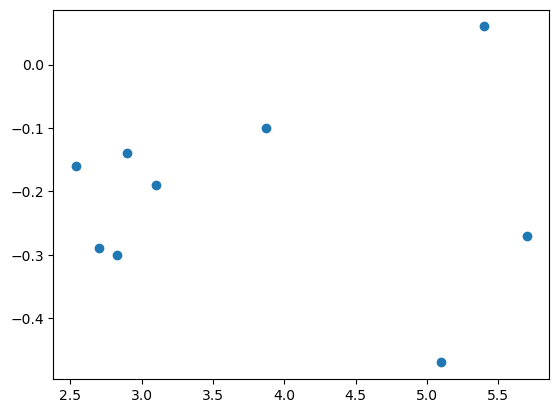

In [175]:
plt.scatter(combined_df['ECS'], combined_df['Forced 100'])

## Plots

In [176]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

In [177]:
vm = 3; step=0.5; levels_shock = np.arange(-vm, vm+step, step)

In [178]:
# Get the existing Spectral colormap
cmap = plt.get_cmap('Spectral_r', len(levels_shock))

# Convert the colormap to a list of colors
colors = cmap(np.linspace(0, 1, cmap.N))

# Find the index range corresponding to the values between -0.5 and 0.5
midpoint_low = np.where(levels_shock == -step)[0][0]
midpoint_high = np.where(levels_shock == step)[0][0]

# Replace the colors between these indices with white
colors[midpoint_low:midpoint_high + 2] = [1, 1, 1, 1]  # RGBA for white

# Create a new colormap from the modified list of colors
custom_cmap = ListedColormap(colors)

# Normalize the colormap so that it fits the levels range
norm = plt.Normalize(vmin=-vm, vmax=vm)

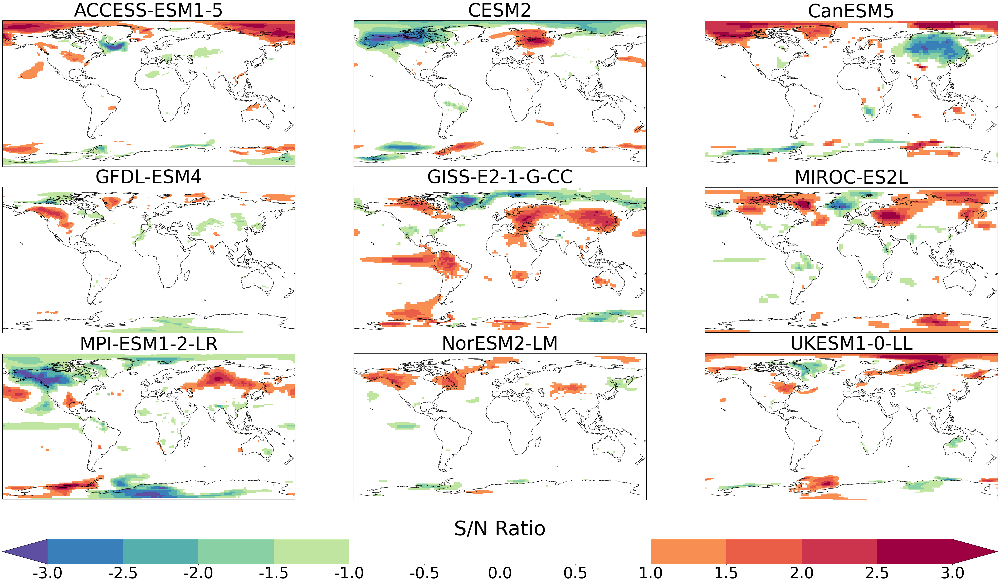

In [179]:
nrows=3; ncols=3
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    a1_anom_data.isel(time=0), dim='model', levels=levels_shock, fig=fig, gs=gs, axes=axes,
    cax=cax, cmap=custom_cmap, #'Spectral',
    cbar_title="S/N Ratio", projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


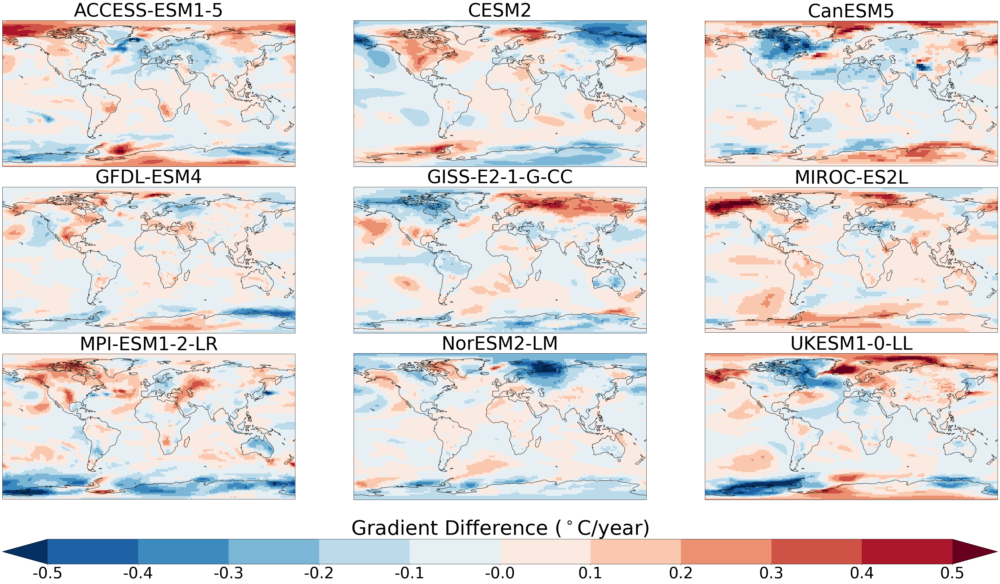

In [180]:
nrows=3; cols=3
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


vm = .5; step=.1; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    start_end_grad_diff, dim='model', levels=levels_anom, fig=fig, gs=gs, axes=axes, cax=cax,
    cbar_title="Gradient Difference " + r'($^\circ$C/year)', projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


In [181]:
from sklearn.metrics import r2_score
import scipy.stats as stats
import seaborn as sns
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
from matplotlib.colors import BoundaryNorm, LinearSegmentedColormap
from scipy import stats

In [182]:

# Define custom colormap with white for 0 to 1 and other colors for higher values
def create_custom_cmap():
    # Define color map for non-zero values
    cmap = plt.get_cmap('PuBuGn', len(discrete_levels) - 1)
    # Add white at the start
    colors = [(1, 1, 1)] + list(cmap(i / (len(discrete_levels) - 1)) for i in range(len(discrete_levels) - 1))
    return LinearSegmentedColormap.from_list('custom_cmap', colors)

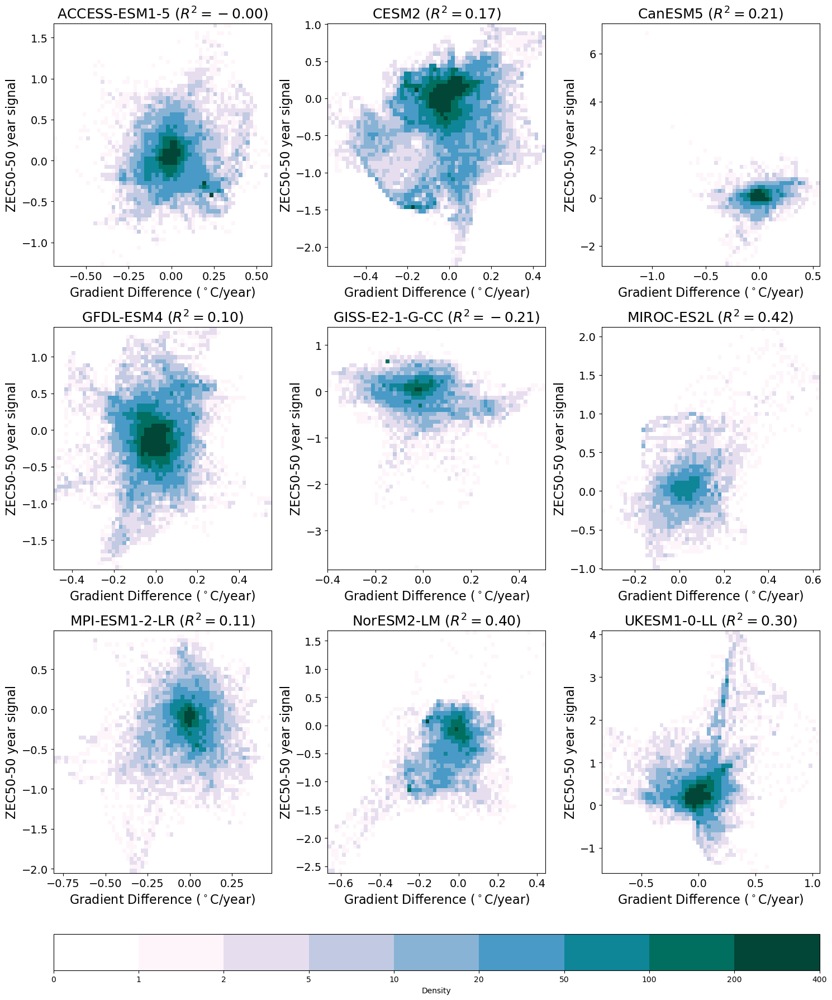

In [183]:
# Define discrete levels
discrete_levels = [0, 1, 2, 5, 10, 20, 50, 100, 200, 400]
cmap = create_custom_cmap()  # Create the custom colormap with white for 0 to 1
norm = BoundaryNorm(discrete_levels, cmap.N)  # Normalize data to the discrete levels

fig = plt.figure(figsize=(15, 18))  # Adjusted figure size
gs = gridspec.GridSpec(4, 3, height_ratios=[1] * 3 + [0.15])
axes = [fig.add_subplot(gs[i]) for i in range(9)]

for num, model in enumerate(start_end_grad_diff.model):
    ax = axes[num]
    arr1 = start_end_grad_diff[model].values.flatten()
    arr2 = (zec50_data[model] - total_50_signal[model]).values.flatten()
    gradient, _, r2, _, _ = stats.linregress(arr1, arr2)

    hist = ax.hist2d(arr1, arr2, bins=60, cmap=cmap, norm=norm)

    # Update title with r^2 value and gradient
    ax.set_title(f'{model} ($R^2 = {r2:.2f})$', fontsize=18)#, Gradient = {gradient:.2f}')
    ax.set_xlabel("Gradient Difference " + r'($^\circ$C/year)', fontsize=16)
    ax.set_ylabel('ZEC50-50 year signal', fontsize=16)
    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)


# Add colorbar in the last row
cbar_ax = fig.add_subplot(gs[-1, :])  # Colorbar subplot spanning the whole last row
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Density')
cbar.set_ticks(discrete_levels)  # Set ticks to match the levels

plt.tight_layout()  # Adjust layout to fit everything

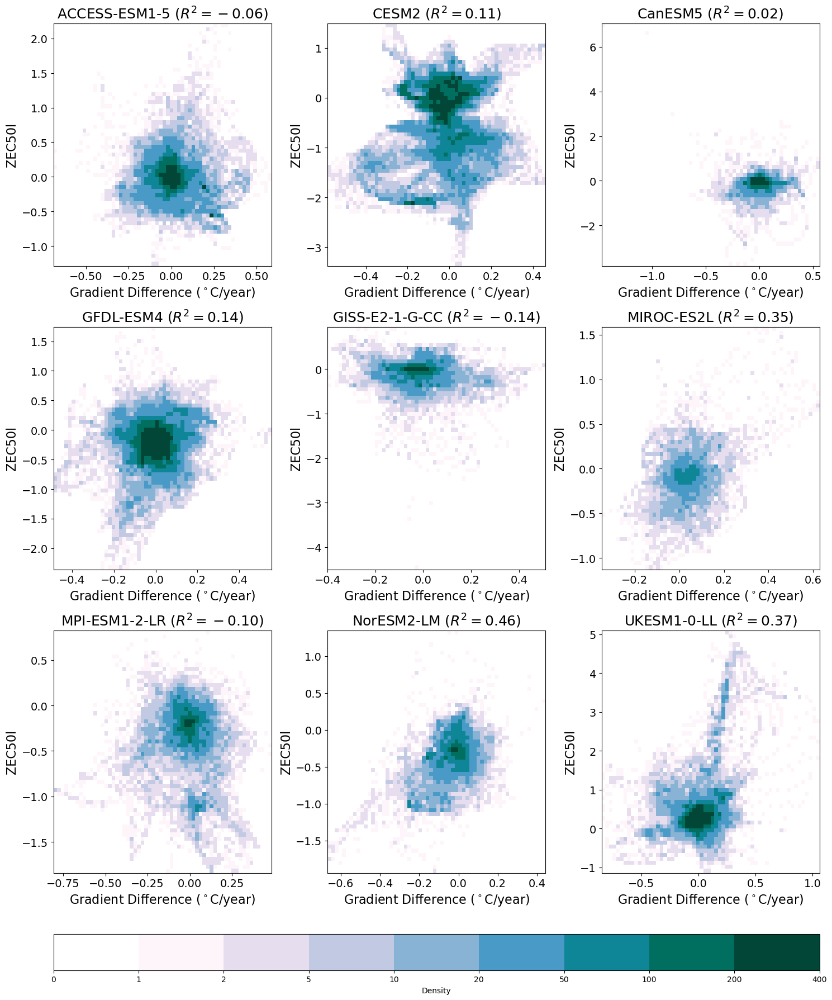

In [233]:
# Define discrete levels
discrete_levels = [0, 1, 2, 5, 10, 20, 50, 100, 200, 400]
cmap = create_custom_cmap()  # Create the custom colormap with white for 0 to 1
norm = BoundaryNorm(discrete_levels, cmap.N)  # Normalize data to the discrete levels

fig = plt.figure(figsize=(15, 18))  # Adjusted figure size
gs = gridspec.GridSpec(4, 3, height_ratios=[1] * 3 + [0.15])
axes = [fig.add_subplot(gs[i]) for i in range(9)]

for num, model in enumerate(start_end_grad_diff.model):
    ax = axes[num]
    arr1 = start_end_grad_diff[model].values.flatten()
    arr2 = zec50_data[model].values.flatten()
    gradient, _, r2, _, _ = stats.linregress(arr1, arr2)

    hist = ax.hist2d(arr1, arr2, bins=60, cmap=cmap, norm=norm)

    # Update title with r^2 value and gradient
    ax.set_title(f'{model} ($R^2 = {r2:.2f})$', fontsize=18)#, Gradient = {gradient:.2f}')
    ax.set_xlabel("Gradient Difference " + r'($^\circ$C/year)', fontsize=16)
    ax.set_ylabel('ZEC50l', fontsize=16)
    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)


# Add colorbar in the last row
cbar_ax = fig.add_subplot(gs[-1, :])  # Colorbar subplot spanning the whole last row
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Density')
cbar.set_ticks(discrete_levels)  # Set ticks to match the levels

plt.tight_layout()  # Adjust layout to fit everything

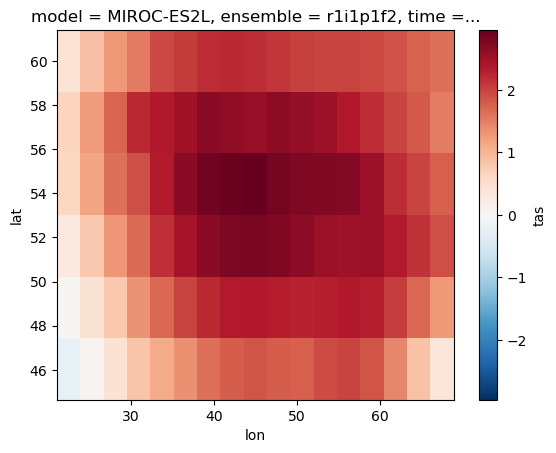

In [192]:
# FInd locations of large shocks
# a1_anom_data[-1].isel(time=0).sel(lat=slice(80, None), lon=slice(50, 100)).plot()

# (a1_anom_data['MPI-ESM1-2-LR']
#  .isel(time=0)
#  .sel(lat=slice(50, 65), lon=slice(220, 240)).plot())


# (a1_anom_data['GISS-E2-1-G-CC']
#  .isel(time=0)
#  .sel(lat=slice(-5, 5), lon=slice(295, 305))
#  .plot()
# )


(a1_anom_data['MIROC-ES2L']
 .isel(time=0)
 .sel(lat=slice(45, 60), lon=slice(20, 70))
 .plot()
)

In [193]:
# a1_anom_data['MPI-ESM1-2-LR'].isel(time=0).sel(lat=57, lon =228, method='nearest')#.values
# a1_anom_data['GISS-E2-1-G-CC'].isel(time=0).sel(lat=-1, lon =301, method='nearest')#.values
a1_anom_data['MIROC-ES2L'].isel(time=0).sel(lat=54, lon =45, method='nearest')#.values

<xarray.DataArray 'tas' (model: 1)> Size: 4B
2.956
Coordinates:
    lat       float64 8B 54.42
    lon       float64 8B 45.0
  * model     (model) <U10 40B 'MIROC-ES2L'
    ensemble  <U8 32B 'r1i1p1f2'
    time      object 8B 0001-12-31 00:00:00

In [194]:
# This location is found to have a really large shock
# THis is for 
model = 'UKESM1-0-LL'
jump_loc = dict(lat=85.5,lon=80, method='nearest')

# model = 'MPI-ESM1-2-LR'
# jump_loc = dict(lat=85.5,lon=80, method='nearest')


# model = 'GISS-E2-1-G-CC'
# jump_loc = dict(lat=-1,lon=301.2, method='nearest')

# model = 'MIROC-ES2L'
# jump_loc = dict(lat=54, lon =45, method='nearest')

In [195]:
branch_year = a1_data[model].time.values[0].year
branch_year

1916

In [196]:
base_period_years =  np.arange(branch_year-10, branch_year+10)

In [197]:
pct_model_subset = pct_resample_data[model].sel(**jump_loc).squeeze()
a1_model_subset = a1_data[model].sel(**jump_loc).isel(time=slice(0, 100)).squeeze()

pct_brach_subset = pct_model_subset.sel(
    time=pct_model_subset.time.dt.year.isin(base_period_years))

In [200]:
a1_subset_slope, a1_subset_fitted = calculate_slope_and_line(a1_model_subset)
# degC per 50 years
a1_subset_slope = a1_subset_slope * 50

Text(0.5, 1.0, '85.5$^\\circ$N, 80$^\\circ$E')

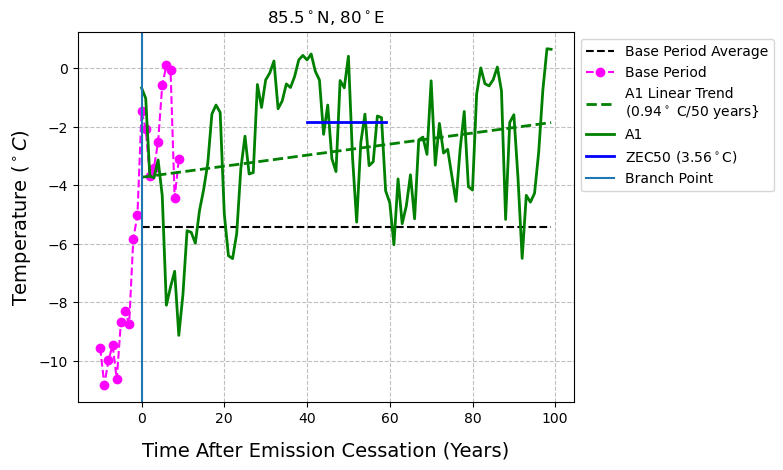

In [201]:
fig = plt.figure()
ax = fig.add_subplot(111)

a1_time = np.arange(0, len(a1_model_subset.time.values))
pct_time = np.arange(-10, 10)

base_period_mean = pct_brach_subset.mean(dim='time').values


ax.plot(
    a1_time,
    # a1_model_subset.time.values,
    np.tile(base_period_mean, len(a1_model_subset.time.values)),
    linestyle='--', color='k', label='Base Period Average')

ax.plot(pct_time, pct_brach_subset.values, color='magenta', label='Base Period',
       linestyle='--', marker='o')

ax.plot(a1_time, a1_subset_fitted, color='green', linewidth=2, linestyle='--',
        label=f'A1 Linear Trend\n({a1_subset_slope:.2f}' + r'$^\circ$ C/50 years}')
ax.plot(a1_time, a1_model_subset.values, color='green', linewidth=2, label='A1')

zec50_val = a1_anom_data[model].sel(**jump_loc).isel(time=slice(40, 60)).mean().values
zec50_loc = a1_model_subset.isel(time=slice(40, 60)).mean().values
ax.plot(np.arange(40, 60),
        np.tile(zec50_loc, 20),
        color='blue', linewidth=2, label=f'ZEC50 ({zec50_val:.2f}' + r'$^\circ$C)')


ax.axvline(0, label='Branch Point')
# There are 20 points, thus there is no exact middle point.
# Make this sit somewhere betweent the two
# ax.scatter(0,
#            (pct_brach_subset.isel(time=9).values + pct_brach_subset.isel(time=10).values)/2, 
#            s=60)

### Styling
ax.legend(ncol=1, bbox_to_anchor=[1, 1])
ax.grid(True, linestyle='--', color='grey', alpha=0.5)
ax.set_xlabel('Time After Emission Cessation (Years)', va='bottom', fontsize=14, labelpad=25);
ax.set_ylabel('Temperature ' + r'($^\circ C$)' , fontsize=14);

ax.set_title(str(jump_loc['lat']) + r'$^\circ$N' + ', ' + str(jump_loc['lon']) + r'$^\circ$E')

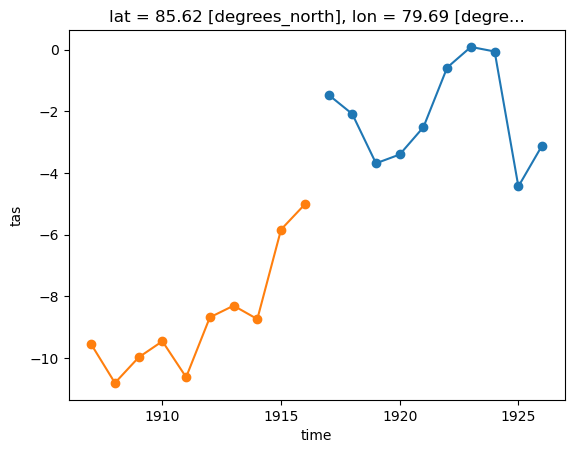

In [202]:
pct_brach_subset.isel(time=slice(10, None)).plot(marker='o')
pct_brach_subset.isel(time=slice(0,10)).plot(marker='o')

In [203]:
calculate_slope(pct_brach_subset.isel(time=slice(10, None)).values)#.mean()

-0.004520294002511291

In [204]:
calculate_slope(pct_brach_subset.values)

0.5596413683762452

In [205]:
calculate_slope(pct_brach_subset.isel(time=slice(0,10)).values)

0.5290126453746449

In [206]:
end_grad_data[-1].sel(**jump_loc)

<xarray.DataArray 'tas' (model: 1)> Size: 8B
-0.00452
Coordinates:
    lat       float64 8B 85.62
    lon       float64 8B 79.69
  * model     (model) <U11 44B 'UKESM1-0-LL'
    ensemble  <U8 32B 'r1i1p1f2'

In [207]:
start_grad_data[-1].sel(**jump_loc).values

array([0.53])

- full garbage collection released 40.69 MiB from 225484 reference cycles (threshold: 9.54 MiB)


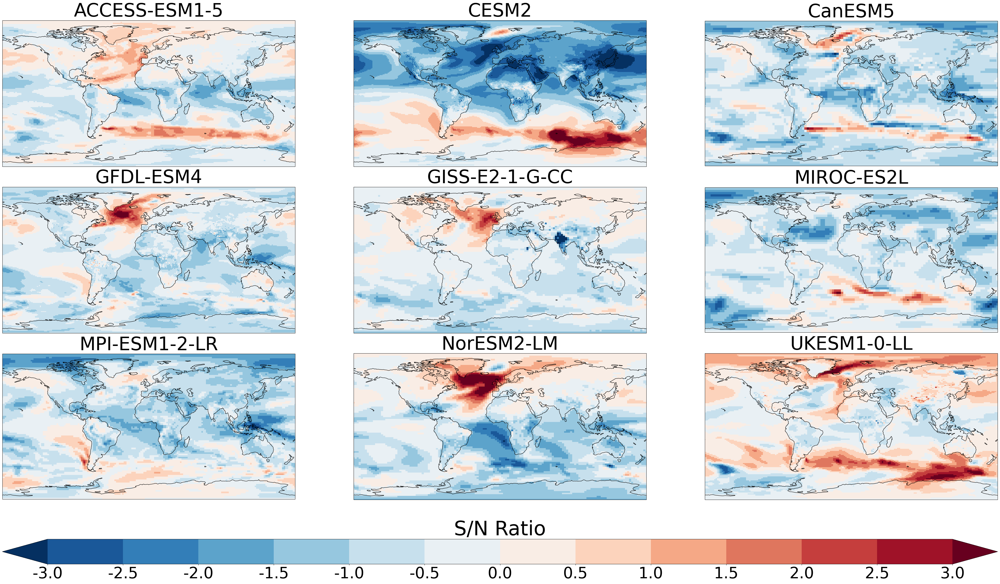

In [208]:
nrows=3; cols=3
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


vm = 3; step=.5; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    total_sn, dim='model', levels=levels_anom, fig=fig, gs=gs, axes=axes, cax=cax,
    cbar_title="S/N Ratio", projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


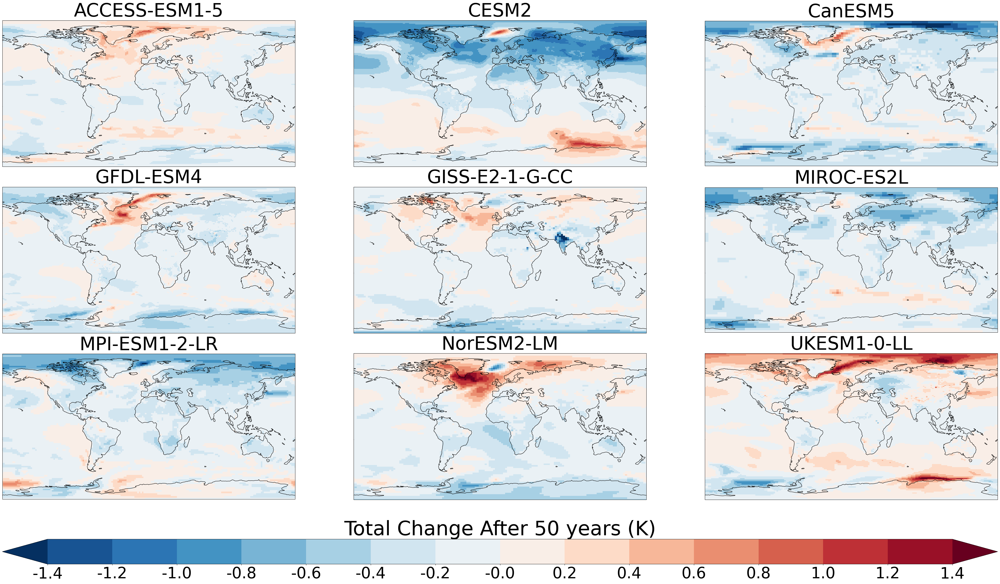

In [212]:
nrows=3; cols=3
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


vm = 1.4; step=.2; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    total_50_signal, dim='model', levels=levels_anom, fig=fig, gs=gs, axes=axes, cax=cax,
    cbar_title="Total Change After 50 years (K)", projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


<Figure size 640x480 with 0 Axes>

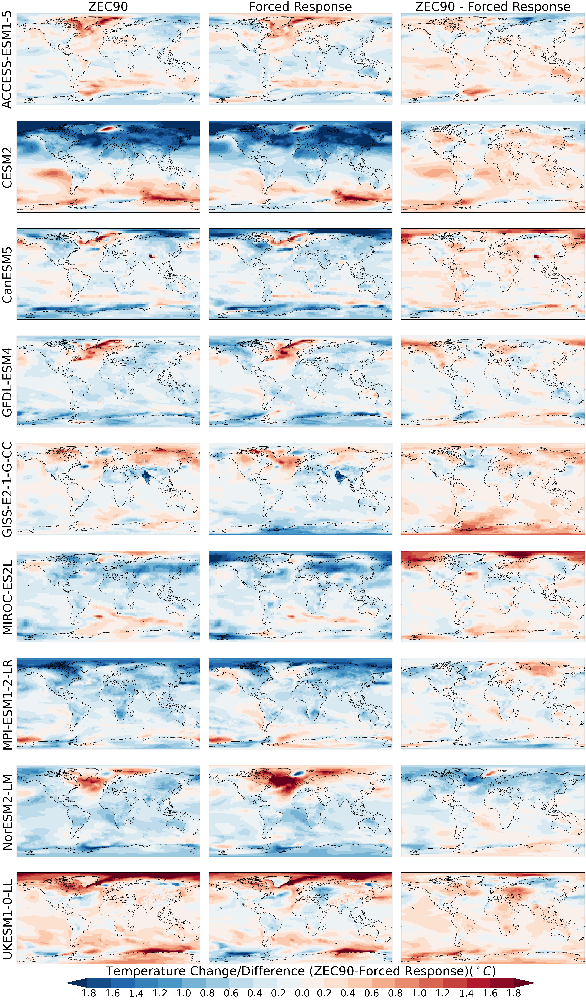

In [213]:
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
nrows=9; ncols=3
fig = plt.figure(figsize=(50, 90))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.3]
                       , hspace=0.15, wspace=0.05)
axes_left = [fig.add_subplot(gs[i, 0], projection=projection_init) for i in range(9)]
axes_middle = [fig.add_subplot(gs[i, 1], projection=projection_init) for i in range(9)]
axes_right = [fig.add_subplot(gs[i, 2], projection=projection_init) for i in range(9)]

cax1 = plt.subplot(gs[nrows, :])
# cax2 = plt.subplot(gs[nrows, 2])


triple_plot_kwargs = dict(projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')

vm = 1.8; step=.2; levels_anom = np.arange(-vm, vm+step, step) 
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    zec90_data, dim='model', levels=levels_anom,
    fig=fig, gs=gs, axes=axes_left, 
    cax=cax1,
    cbar_title="Total Change After 100 years (K)",
    **triple_plot_kwargs)

fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    total_signal, dim='model', levels=levels_anom,
    fig=fig, gs=gs, axes=axes_middle, 
    cax=cax1,
    cbar_title="Total Change After 100 years (K)", 
    **triple_plot_kwargs)


fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    zec90_data-total_signal, dim='model', levels=levels_anom,
    fig=fig, gs=gs, axes=axes_right, cax=cax1,
    cbar_title="Temperature Change/Difference (ZEC90-Forced Response)" + r'($^\circ C$)',
    **triple_plot_kwargs)


for num, (ax1, ax2, ax3) in enumerate(zip(axes_left, axes_middle, axes_right)):
    ax1.annotate(ax1.get_title(), xy=(-0.05, 0.5), xycoords = 'axes fraction',
                 ha='center', va='center', fontsize=60, rotation=90)

    if num == 0:
        ax1.set_title('ZEC90', fontsize=60)
        ax2.set_title('Forced Response', fontsize=60)
        ax3.set_title('ZEC90 - Forced Response', fontsize=60)
    else:
        [ax.set_title('') for ax in [ax1, ax2, ax3]]


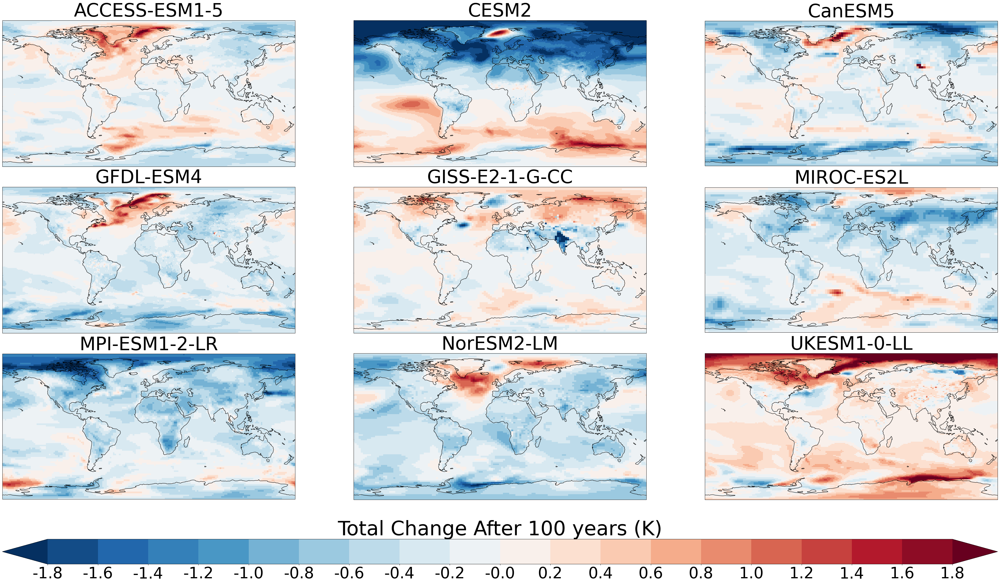

In [215]:
nrows=3; cols=3
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


vm = 1.8; step=.2; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    zec90_data, dim='model', levels=levels_anom, fig=fig, gs=gs, axes=axes, cax=cax,
    cbar_title="Total Change After 100 years (K)", projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


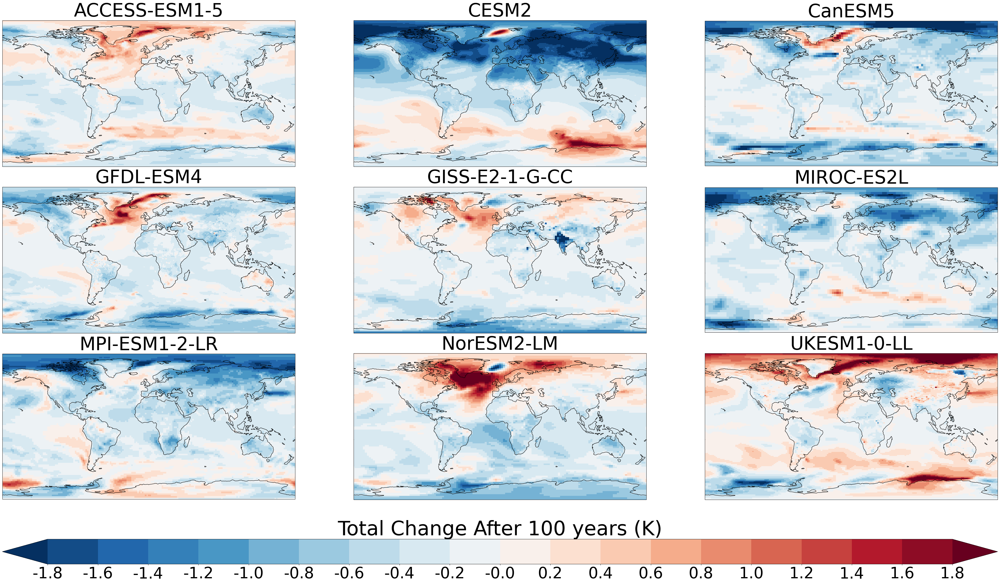

In [216]:
nrows=3; cols=3
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


vm = 1.8; step=.2; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    total_signal, dim='model', levels=levels_anom, fig=fig, gs=gs, axes=axes, cax=cax,
    cbar_title="Total Change After 100 years (K)", projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


In [217]:
# signal_100_ds, noise_100_ds ,sn_ratio_100_ds = a1_anom_data(
#     sn_calc.signal_to_noise_ratio,
#     100, 
#     detrended_data=a1_anom_detrend_data
#     , noise_type='static', logginglevel='INFO', return_all=True)

Text(0.5, 0, 'Standard Deviation$ (^\\circ C)$')

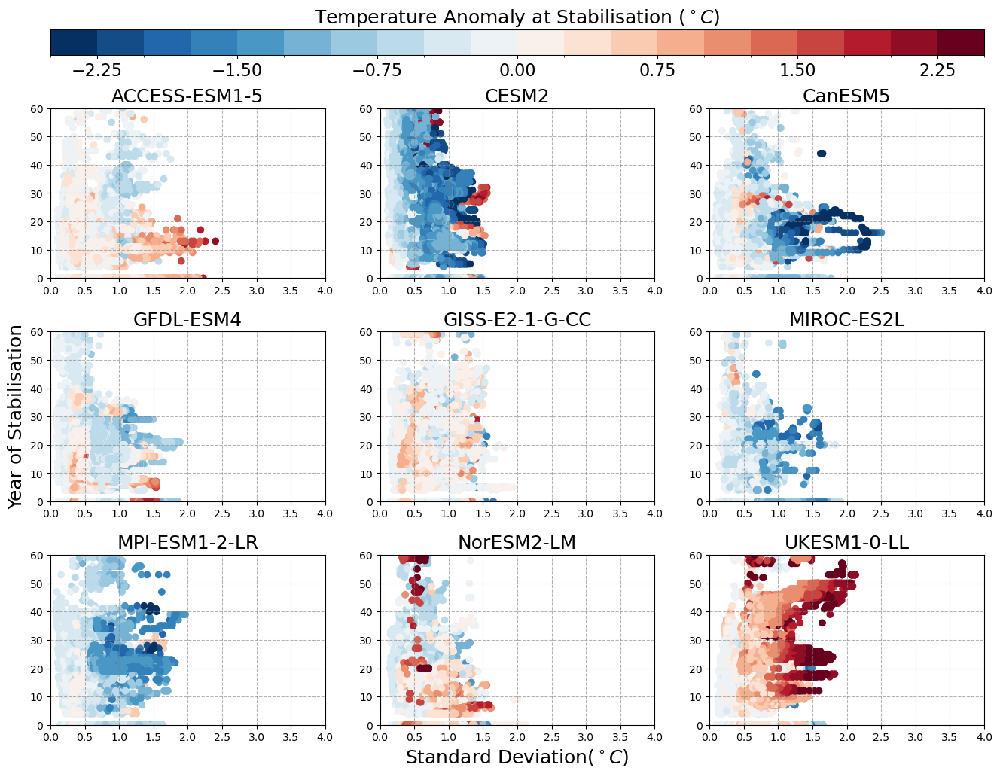

In [219]:
fig = plt.figure(figsize=(16, 12))
gs = gridspec.GridSpec(4, 3, height_ratios=[0.15, 1, 1, 1], hspace=0.4) 

axes =[fig.add_subplot(gs[i+3]) for i in range(9)]
# Create a position for the colorbar on top
cbar_ax = fig.add_subplot(gs[0, :])

# Define levels for the discrete colorbar
levels = np.arange(-2.5, 2.75, 0.25)

# Create a colormap and normalize with the levels
cmap = plt.get_cmap('RdBu_r')
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

# Create subplots
for num, model in enumerate(static_noise_data.model):
    ax = axes[num]
    ax.grid(True, linestyle='--', color='grey', alpha=0.6, zorder=-1000)

    sc = ax.scatter(static_noise_data[model].values.flatten(),
                    year_stable_data[model].values.flatten(), 
                    c=total_signal[model].values.flatten(), cmap=cmap, norm=norm) 
    #zec50_data, stable_anom_da
    ax.set_title(model, fontsize=18)
    ax.set_xlim(0,4)
    ax.set_ylim(0, 60)
    
# Add the colorbar
cbar = fig.colorbar(sc, cax=cbar_ax, orientation='horizontal')
cbar.ax.set_title('Temperature Anomaly at Stabilisation ' + r'$ (^\circ C)$', fontsize=18)

cbar.ax.tick_params(labelsize=16)  # Increase font size of the tick labels

axes[3].set_ylabel('Year of Stabilisation', fontsize=18)
axes[7].set_xlabel('Standard Deviation'  + r'$ (^\circ C)$', fontsize=18)


In [223]:
# a1_anom_data[model].sel(**lat_lon_dict).rolling(time=20).mean()

<Axes: xlabel='Time After Emission Cessation (Years)', ylabel='GMST\nAnomaly ($^{\\circ}C$)'>

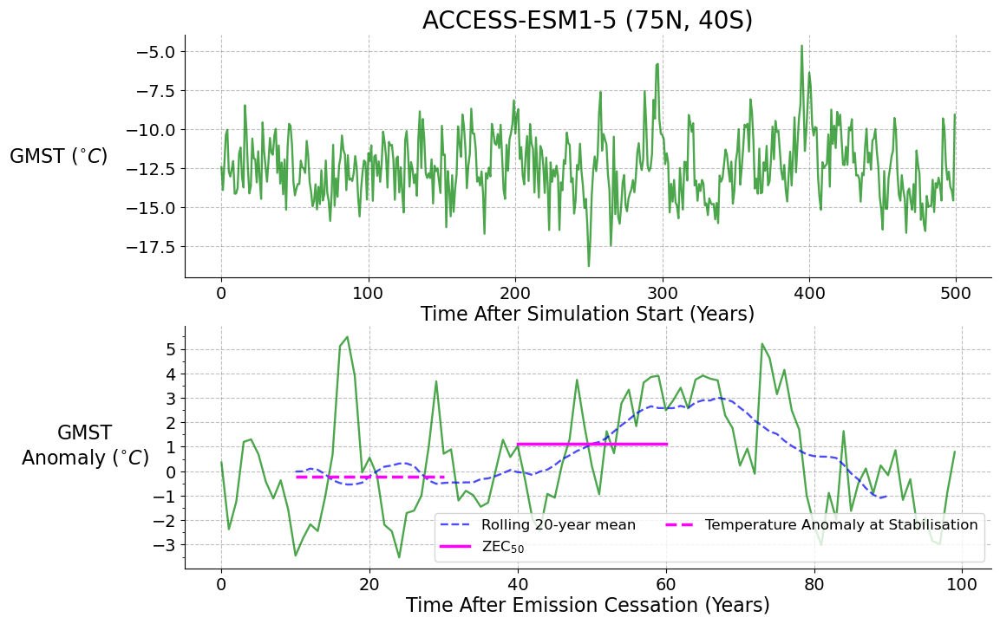

In [290]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
ax2 = fig.add_subplot(212)
lat_lon_dict = dict(lat=80, lon=67.5, method='nearest')

model = 'ACCESS-ESM1-5'
ax1.plot(esmpi_data[model].sel(**lat_lon_dict).isel(time=slice(0,500)).squeeze().values,
        color='green', alpha=0.7, linewidth=1.7,);
ax2.plot(a1_anom_data[model].sel(**lat_lon_dict).squeeze().values,
         color='green', linewidth=1.7, alpha=0.7);

# slope, fitted_line = calculate_slope_and_line(
#     a1_anom_data[model].sel(**lat_lon_dict).squeeze().values)
# ax2.plot(np.arange(len(fitted_line)), fitted_line, 
#         color='black', linewidth=2)

ax2.plot(
    (a1_anom_data[model].sel(**lat_lon_dict).squeeze()
     .rolling(time=20, center=True).mean().values),
color='blue', linewidth=1.7, alpha=0.7, linestyle='--', label='Rolling 20-year mean');

ax2.plot(np.arange(40, 61),
    np.tile(zec50_data[model].sel(**lat_lon_dict).values, 21),
        linewidth=2.5, color='magenta', label='ZEC'+r'$_{50}$')

ax2.plot(np.arange(
    year_stable_data[model].sel(**lat_lon_dict).values,
    year_stable_data[model].sel(**lat_lon_dict).values+21),
    np.tile(stable_anom_da[model].sel(**lat_lon_dict).values, 21),
        linewidth=2.5, color='magenta', linestyle='--', 
        label='Temperature Anomaly at Stabilisation')

ax2.legend(ncol=2, fontsize=12)

plotting_functions.format_axis(
    ax1, xlabel='Time After Simulation Start (Years)', title=f'{model} (75N, 40S)',
    ylabel='GMST'+r' ($^{\circ}C$)',
    labelpad=55, invisible_spines=['top', 'right'])



ax2.yaxis.set_major_locator(mticker.MultipleLocator(1))
ax2.yaxis.set_minor_locator(mticker.MultipleLocator(.5))

plotting_functions.format_axis(
    ax2, xlabel='Time After Emission Cessation (Years)', title='',
    ylabel='GMST\n'+r'Anomaly ($^{\circ}C$)',
    labelpad=55, invisible_spines=['top', 'right'])

# ax1.set_xticklabels(a1_anom_data.isel(time=slice(14, 60)).time.dt.year.values[::15])

In [291]:
arr = a1_anom_data[model].sel(**lat_lon_dict).squeeze().values
arr.shape

(100,)

In [292]:
window = 30
signal_list = []
noise_list = []
for t in range(len(arr)-window):
    arr_subset = arr[t:t+window]
    slope = calculate_slope(arr_subset) * window
    noise = np.std(arr_subset)
    signal_list.append(slope)
    noise_list.append(noise)
signal_list = np.array(signal_list)
noise_list = np.array(noise_list)
sn_list = signal_list/noise_list

In [293]:
actual_values = sn_ratio_a1_data.sel(model=model).sel(**lat_lon_dict).sel(window=window).squeeze().values

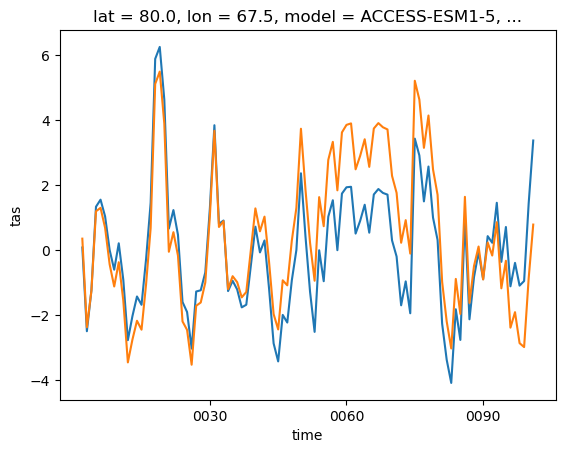

In [294]:
a1_anom_detrend_data.sel(model=model).sel(**lat_lon_dict).plot()
a1_anom_data.sel(model=model).sel(**lat_lon_dict).plot()

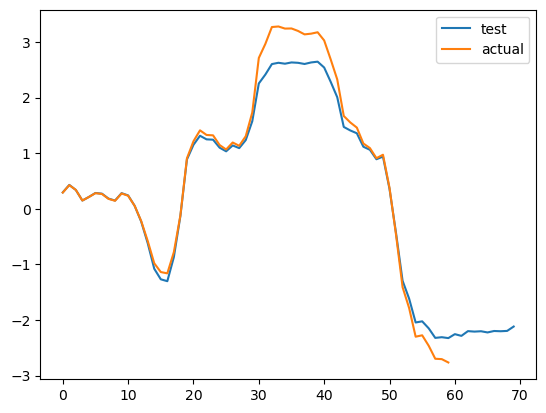

In [295]:
# plt.plot(actual_values)
plt.plot(sn_list, label='test')
plt.plot(actual_values, label='actual')
plt.legend()

In [225]:
diff_stable_and_zec50_data = zec50_data - stable_anom_da

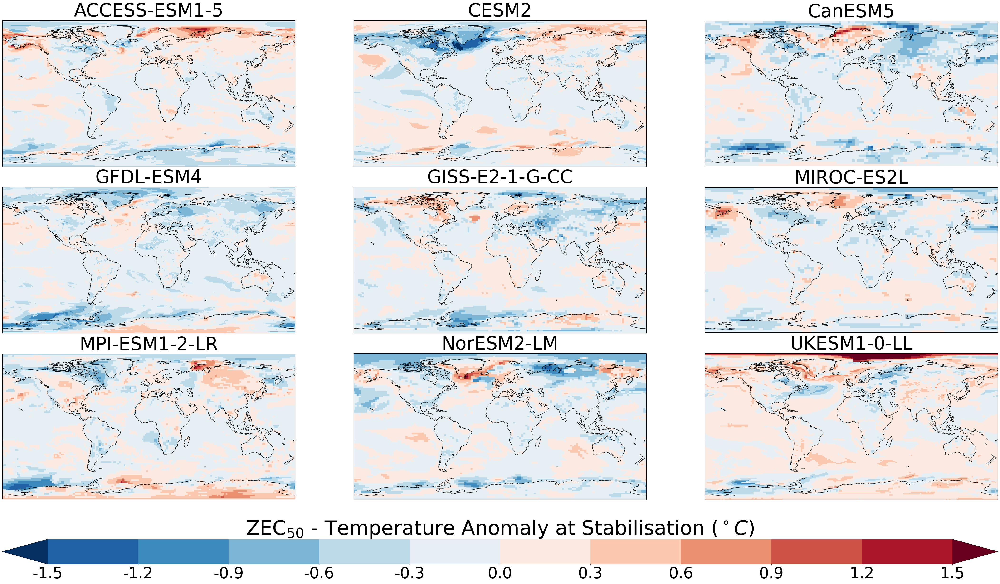

In [228]:
fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.1]+[0.15], hspace=0.1)
axes = [fig.add_subplot(gs[i], projection=projection_init) for i in range(0, num_plots)]
cax = plt.subplot(gs_bottom[nrows+1, :])


vm = 1.5; step=.3; levels_diff= np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    diff_stable_and_zec50_data, dim='model', levels=levels_diff, fig=fig, gs=gs, axes=axes, cax=cax,
    cbar_title="ZEC" + r'$_{50}$' + ' - Temperature Anomaly at Stabilisation ' + r'$(^\circ C)$', 
    projection=ccrs.PlateCarree, 
    add_label=False, font_scale=2.8, 
    logginglevel='ERROR', ptype='imshow')


# TCRE local ZEC correlation

In [ ]:
ecs_dict = {
    'NorESM2-LM': 2.54,
    'MIROC-ES2L': 2.7,
    'MPI-ESM1-2-LR': 2.83,
    'GISS-E2-1-G-CC': 2.9,
    'GFDL-ESM4': 3.1,
    'ACCESS-ESM1-5': 3.87,
    'CESM2': 5.1,
    'UKESM1-0-LL': 5.4,
    'CanESM5': 5.7
}

In [ ]:
# This comes from the ZEC nat var paper
tcre_dict = {
    'ACCESS-ESM1-5': 1.81,
    'CESM2': 2.01,
    'CanESM5': 2.10,
    'GFDL-ESM4': 1.36,
    'GISS-E2-1-G-CC': 1.68,
    'MIROC-ES2L': 1.36,
    'MPI-ESM1-2-LR': 1.65,
    'NorESM2-LM': 1.42,
    'UKESM1-0-LL': 2.65
}

In [ ]:
from scipy.stats import spearmanr

In [ ]:
def apply_correlation(arr1, arr2):
    if np.all(np.isnan(arr1)) or np.all(np.isnan(arr2)): return np.nan

    finite_locs = np.isfinite(arr1)
    arr1 = arr1[finite_locs]
    arr2 = arr2[finite_locs]

    return spearmanr(arr1, arr2).statistic

In [ ]:
list(tcre_dict.values())

In [ ]:
apply_correlation_tcre = partial(apply_correlation, arr2=np.array(list(tcre_dict.values())))
tcre_correlation = xr.apply_ufunc(
    apply_correlation_tcre,
    stable_anom_da.sel(model=list(tcre_dict)), # make sure same order
    input_core_dims=[['model']], 
    output_core_dims=[[]],
    vectorize=True
)

In [ ]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection=ccrs.PlateCarree())
tcre_correlation.plot(ax=ax, levels=np.arange(-1, 1.1, .1))
ax.coastlines()

In [ ]:
apply_correlation_ecs = partial(apply_correlation, arr2=np.array(list(ecs_dict.values())))
ecs_correlation = xr.apply_ufunc(
    apply_correlation_ecs,
    stable_anom_da.sel(model=list(tcre_dict)), # make sure same order
    input_core_dims=[['model']], 
    output_core_dims=[[]],
    vectorize=True
)

In [ ]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection=ccrs.PlateCarree())
ecs_correlation.plot(ax=ax, levels=np.arange(-1, 1.1, .1))
ax.coastlines()

In [ ]:
stable_anom_da.sel(model=list(tcre_dict))

# Drift Comparison (Figure S11)

In [ ]:
#### TODO: Do not import as *. Add drift_functino. as prefix to all necissary functions
from drift_functions import *

In [ ]:
# P-values
pi_pval_da = calculate_pvals(
    esmpi_data.chunk({'time':-1, 'model':1, 'lat': int(96/4)}).isel(time=slice(0, 100)))

In [ ]:
a1_anom_data

In [ ]:
exp_pval_da = calculate_pvals(a1_anom_data)

In [ ]:
exp_pval_da.isel(model=0).plot()

In [ ]:
# Just the p-values that are less tha 0.05
pi_sig_da = xr.where(pi_pval_da < 0.05, 1, np.nan)#.astype(int)
exp_sig_da = xr.where(exp_pval_da < 0.05, 1, np.nan)#.astype(int)

In [ ]:
fig = plt.figure(); ax = fig.add_subplot(111, projection=ccrs.Robinson())
sn_plotting.plot_stippled_data(pi_sig_da.isel(model=0), ax)

In [ ]:
# Calculating the gradient over the 100 year run length
gradient_exp_full_da = calculate_trend(a1_anom_data);
gradient_pi_full_da = calculate_trend(esmpi_data.isel(time=slice(0, 100)))

In [ ]:
# Multiplying gradient by 50 to get K per 50 years
gradient_exp_full_da = (gradient_exp_full_da*50).persist()
gradient_pi_full_da = (gradient_pi_full_da*50).persist()

In [ ]:
# Difference in the gradients
gradient_full_diff = gradient_exp_full_da-gradient_pi_full_da

In [ ]:
reload(sn_plotting)

In [ ]:
# All mean value plots
models = gradient_full_diff.model.values
nrows = len(models); ncols = 3
fig = plt.figure(figsize=(6*ncols, 8*ncols))
gs = gridspec.GridSpec(nrows+1, ncols, height_ratios = [1]*nrows +[0.2], hspace=.2, wspace=0)
projection = ccrs.PlateCarree(central_longitude=int(np.mean(gradient_full_diff.lon.values)))

drift_plot_levels = np.arange(-1.4, 1.4, .2)
drift_plot_kwargs = dict(levels=drift_plot_levels, extend='both', cmap='RdBu_r', add_label=False, font_scale=0.7)
vm =40; step=5; levels_mean_stab2 = np.arange(0, vm+step, step)
all_axes = []

### A1

fig, gs, axes1 = sn_plotting.map_plot_all_for_coords_3(
    gradient_exp_full_da, dim='model',
    fig=fig, gs=gs, add_colorbar=False, stipling_da=exp_sig_da,
    axes = [fig.add_subplot(gs[i, 0], projection=projection) for i in range(len(models))],
    **drift_plot_kwargs)

for num, (ax, model) in enumerate(zip(axes1, models)):
    # ax.set_ylabel(model, labelpad=500)
    # sn_plotting.plot_stippled_data(pi_sig_da.sel(model=model), ax) # TODO: This is not working in the `map_plot_all_for_coords_3` function
    if num == 0: ax.set_title('A1 Experiment', fontsize=plotting_functions.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
    else: ax.set_title('')
    
y_axis_kwargs = dict(xy=(-.25, 0.5), ha='center', va='center', xycoords='axes fraction', rotation=0,
                     size=plotting_functions.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
for model, ax in zip(models, axes1): ax.annotate(model, **y_axis_kwargs)
all_axes.extend(axes1)


#### Pi-control

fig, gs, axes2 = sn_plotting.map_plot_all_for_coords_3(
    gradient_pi_full_da, dim='model',
    fig=fig, gs=gs, add_colorbar=False,stipling_da=pi_sig_da, 
    axes = [fig.add_subplot(gs[i, 1], projection=projection) for i in range(len(models))],
    **drift_plot_kwargs)
for ax in axes2: ax.set_title('')
axes2[0].set_title('Pre-Industrial Control', size=plotting_functions.PlotConfig.title_size*drift_plot_kwargs['font_scale'])

all_axes.extend(axes2)

### Diff

fig, gs, axes3, cbar = sn_plotting.map_plot_all_for_coords_3(
    gradient_full_diff, dim='model',
    cbar_title="Gradient (K /(50 year))", fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[i, 2], projection=projection) for i in range(len(models))],
    cax = plt.subplot(gs[nrows, :]), 
    **drift_plot_kwargs)


for ax in axes3: ax.set_title('')
axes3[0].set_title('Difference', size=plotting_functions.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
all_axes.extend(axes3)

#for num, ax in enumerate(all_axes): plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=0.7)